# <font style = "color:rgb(50,120,229)"> Coin Detection </font>

So far we have studied about various mophological operations and different thresholding techniques in some detail. Now it's time to apply these concepts for a practical application - **Coin Detection**.

## <font style = "color:rgb(50,120,229)"> Aim </font>

In this assignment, you will work with 2 different images (so 2 different parts) and will use **only** morphological operations and thresholding techniques to detect the total number of coins present in the image. Your submission will be graded based on your use of the concepts covered in this module, experimentation performed to achieve at your final solution, documentation, and finally, the total number of coins successfully detected in the images. Each part will be of 15 marks. This assignment will be entirely **manually graded** so make sure that you do NOT remove any experimentation you have done as well as the observation you made after each step.

**Proper documentation for each step should be provided with help of markdown**

## <font style = "color:rgb(50,120,229)">Outline</font>

The main steps that you can follow to solve this assignment are:

1. Read the image.
2. Convert it to grayscale and split the image into the 3 (Red, Green and Blue) channels. Decide which of the above 4 images you want to use in further steps and provide reason for the same.
3. Use thresholding and/or morphological operations to arrive at a final binary image.
4. Use **simple blob detector** to count the number of coins present in the image.
5. Use **contour detection** to count the number of coins present in the image.
6. Use **CCA** to count the number of coins present in the image.

**We have also provided the results we obtained at the intermediate steps for your reference.**

# <font style = "color:rgb(50,120,229)">Assignment Part - A</font>

## <font style = "color:rgb(50,120,229)"> Step 1: Read Image</font>

In [1]:
import cv2
import matplotlib.pyplot as plt
from dataPath import DATA_PATH
import numpy as np
%matplotlib inline

In [2]:
import matplotlib
matplotlib.rcParams['figure.figsize'] = (10.0, 10.0)
matplotlib.rcParams['image.cmap'] = 'gray'

Text(0.5, 1.0, 'Original Image')

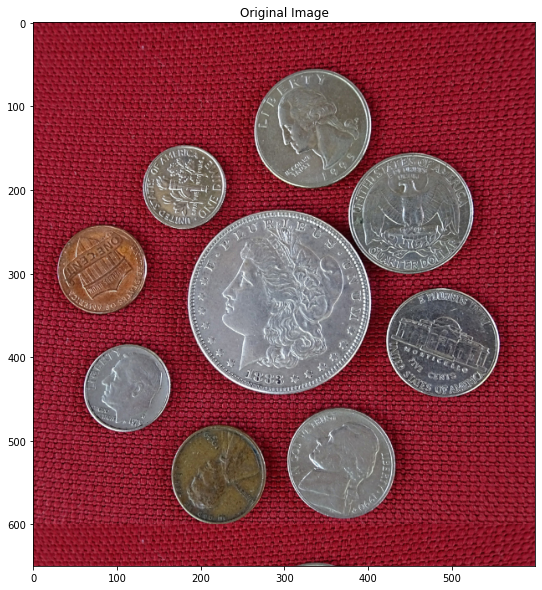

In [3]:
# Image path
imagePath = DATA_PATH + "images/CoinsA.png"
# Read image
# Store it in the variable image
###
### YOUR CODE HERE
###
image = cv2.imread(imagePath)
imageCopy = image.copy()
plt.imshow(image[:,:,::-1]);
plt.title("Original Image")

## <font style = "color:rgb(50,120,229)">Step 2.1: Convert Image to Grayscale</font>

In [4]:
# Convert image to grayscale
# Store it in the variable imageGray
###
### YOUR CODE HERE
###
imageGray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

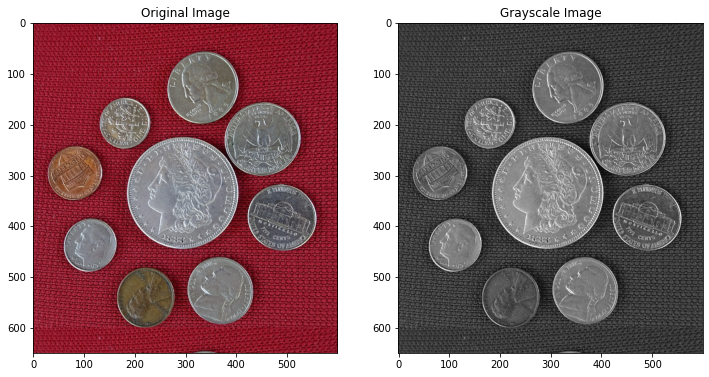

In [5]:
plt.figure(figsize=(12,12))
plt.subplot(121)
plt.imshow(image[:,:,::-1]);
plt.title("Original Image")
plt.subplot(122)
plt.imshow(imageGray);
plt.title("Grayscale Image");

## <font style = "color:rgb(50,120,229)">Step 2.2: Split Image into R,G,B Channels</font>

In [6]:
# Split cell into channels
# Store them in variables imageB, imageG, imageR
###
### YOUR CODE HERE
###
imageB = image[:, :, 0]
imageG = image[:, :, 1]
imageR = image[:, :, 2]

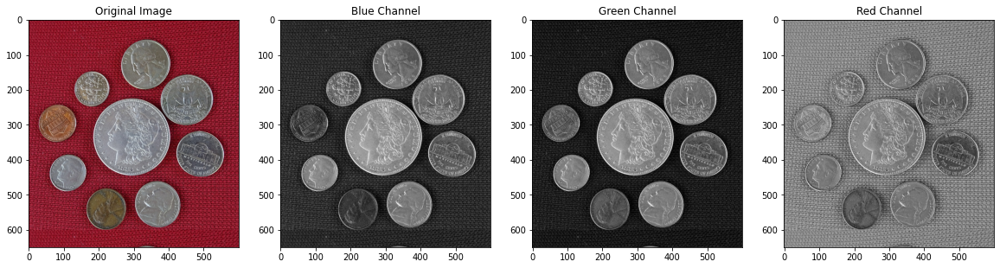

In [7]:
plt.figure(figsize=(20,12))
plt.subplot(141)
plt.imshow(image[:,:,::-1]);
plt.title("Original Image")
plt.subplot(142)
plt.imshow(imageB);
plt.title("Blue Channel")
plt.subplot(143)
plt.imshow(imageG);
plt.title("Green Channel")
plt.subplot(144)
plt.imshow(imageR);
plt.title("Red Channel");

## <font style = "color:rgb(50,120,229)">Step 3.1: Perform Thresholding</font>

You will have to carry out this step with different threshold values to see which one suits you the most. Do not remove those intermediate images and make sure to document your findings.

In [8]:
###
### YOUR CODE HERE
###
def thresholdingTrials(src, thresh, maxValue):
    # Binary Thresholding 
    th, dst_bin = cv2.threshold(src, thresh, maxValue, cv2.THRESH_BINARY)
    # Inverse Binary Thresholding 
    th, dst_bin_inv = cv2.threshold(src, thresh, maxValue, cv2.THRESH_BINARY_INV)
    # Truncate Thresholding 
    th, dst_trunc = cv2.threshold(src, thresh, maxValue, cv2.THRESH_TRUNC)
    # Threshold to Zero 
    th, dst_to_zero = cv2.threshold(src, thresh, maxValue, cv2.THRESH_TOZERO)
    # Inverted Threshold to Zero
    th, dst_to_zero_inv = cv2.threshold(src, thresh, maxValue, cv2.THRESH_TOZERO_INV)
    print("Threshold Value = {}, Max Value = {}".format(thresh, maxValue))
    plt.figure(figsize=[20,12])
#     plt.subplot(231);plt.imshow(src, cmap='gray', vmin=0, vmax=255);plt.title("Original Image");
#     plt.subplot(232);plt.imshow(dst_bin, cmap='gray', vmin=0, vmax=255);plt.title("Threshold Binary");
#     plt.subplot(233);plt.imshow(dst_bin_inv, cmap='gray', vmin=0, vmax=255);plt.title("Threshold Binary Inverse");
#     plt.subplot(234);plt.imshow(dst_trunc, cmap='gray', vmin=0, vmax=255);plt.title("Threshold Truncate");
#     plt.subplot(235);plt.imshow(dst_to_zero, cmap='gray', vmin=0, vmax=255);plt.title("Threshold To Zero");
#     plt.subplot(236);plt.imshow(dst_to_zero_inv, cmap='gray', vmin=0, vmax=255);plt.title("Threshold To Zero Inverse");
    plt.subplot(231);plt.imshow(src);plt.title("Original Image");
    plt.subplot(232);plt.imshow(dst_bin);plt.title("Threshold Binary");
    plt.subplot(233);plt.imshow(dst_bin_inv);plt.title("Threshold Binary Inverse");
    plt.subplot(234);plt.imshow(dst_trunc);plt.title("Threshold Truncate");
    plt.subplot(235);plt.imshow(dst_to_zero);plt.title("Threshold To Zero");
    plt.subplot(236);plt.imshow(dst_to_zero_inv);plt.title("Threshold To Zero Inverse");

Threshold Value = 100, Max Value = 150


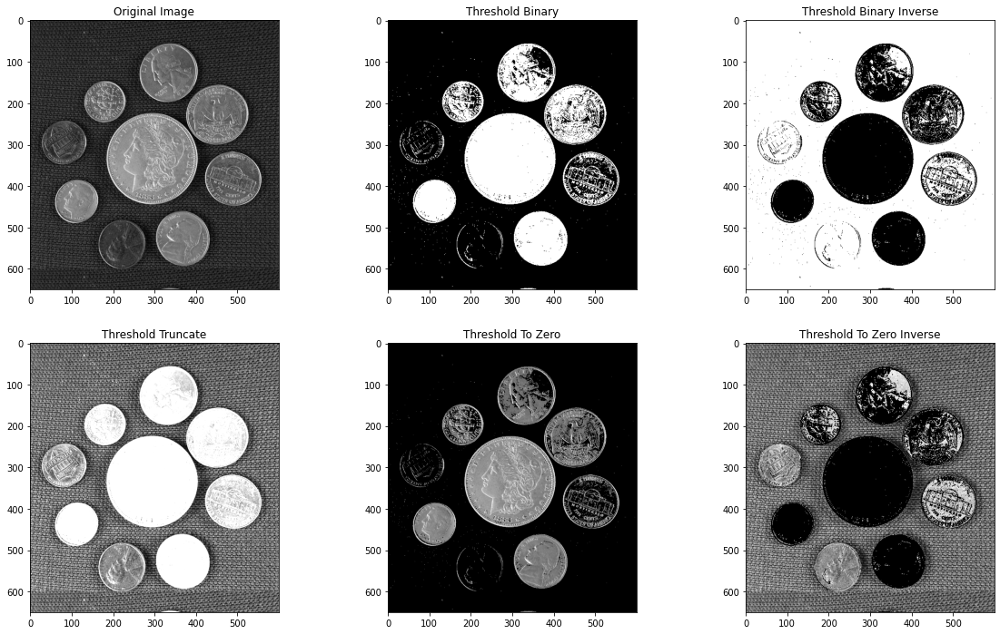

In [9]:
thresh = 100
maxValue = 150
thresholdingTrials(imageB, thresh, maxValue)

Threshold Value = 100, Max Value = 150


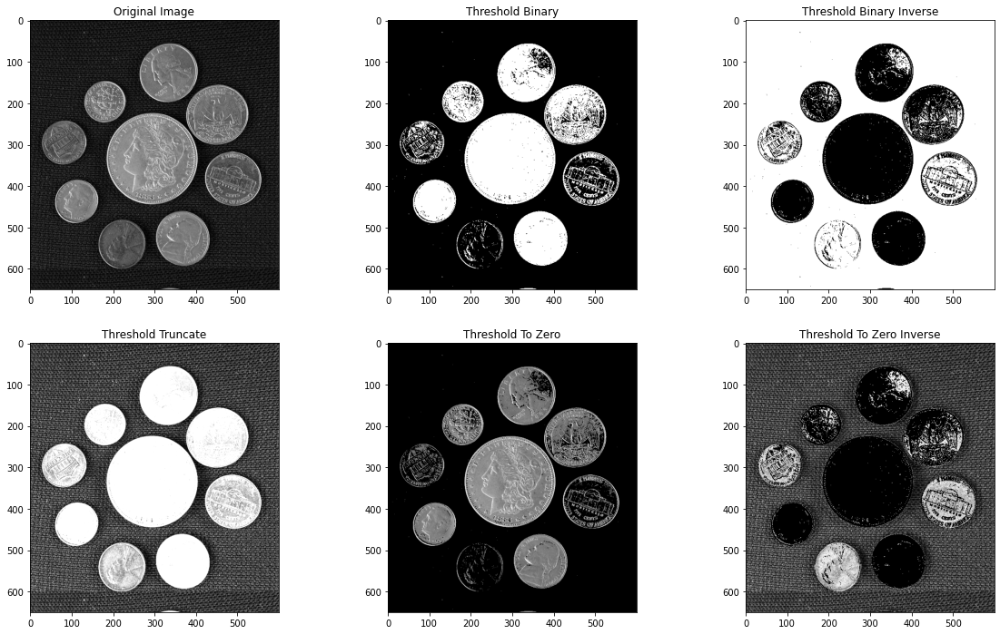

In [10]:
thresholdingTrials(imageG, thresh, maxValue)

Threshold Value = 100, Max Value = 150


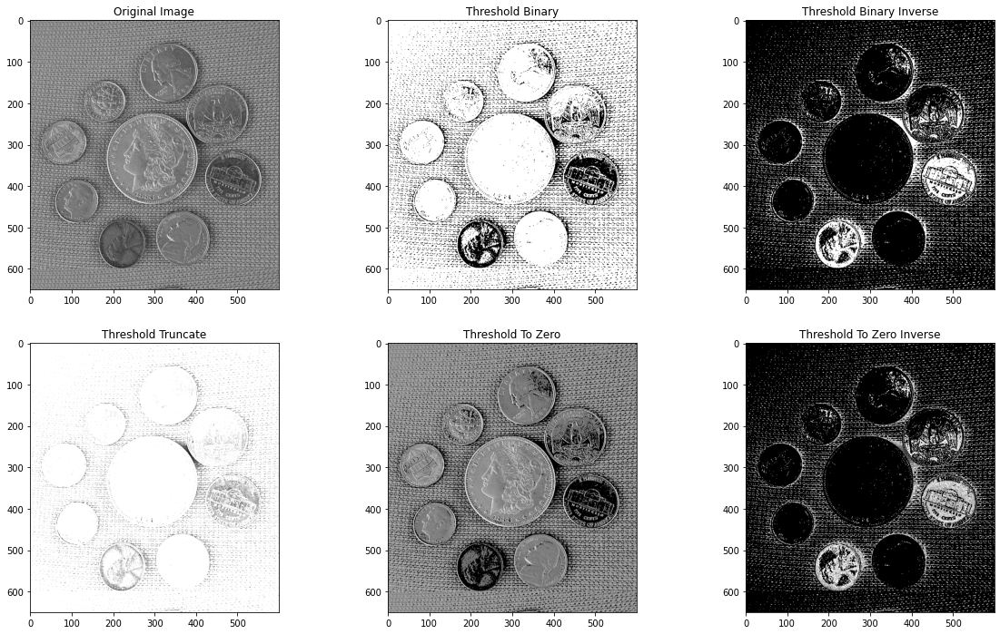

In [11]:
thresholdingTrials(imageR, thresh, maxValue)

Threshold Value = 100, Max Value = 150


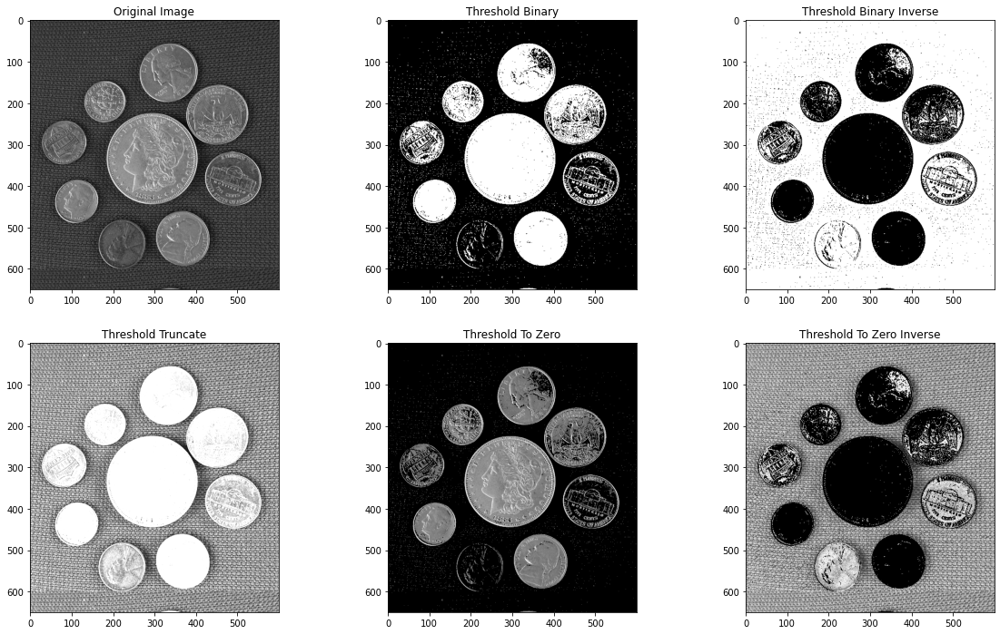

In [12]:
thresholdingTrials(imageGray, thresh, maxValue)

In [13]:
def thresholdingActual(src, thresh, maxValue):
    # thresholding truncate
    th, dst_trunc = cv2.threshold(src, thresh, maxValue, cv2.THRESH_TRUNC)

    # threshold binary inverse
    th, dst_bin_inv = cv2.threshold(dst_trunc, 20, 100, cv2.THRESH_BINARY_INV)
    
    plt.figure(figsize=[20,12])
    plt.subplot(131);plt.imshow(src);plt.title("Original Image");
    plt.subplot(132);plt.imshow(dst_trunc);plt.title("Threshold Truncate");
    plt.subplot(133);plt.imshow(dst_bin_inv);plt.title("Threshold Binary Inverse");
    
    return dst_bin_inv

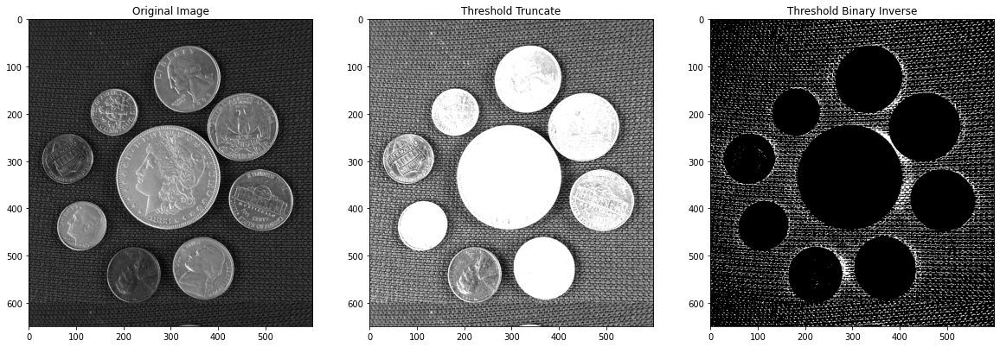

In [14]:
thresholdingActual(imageB, thresh, maxValue);

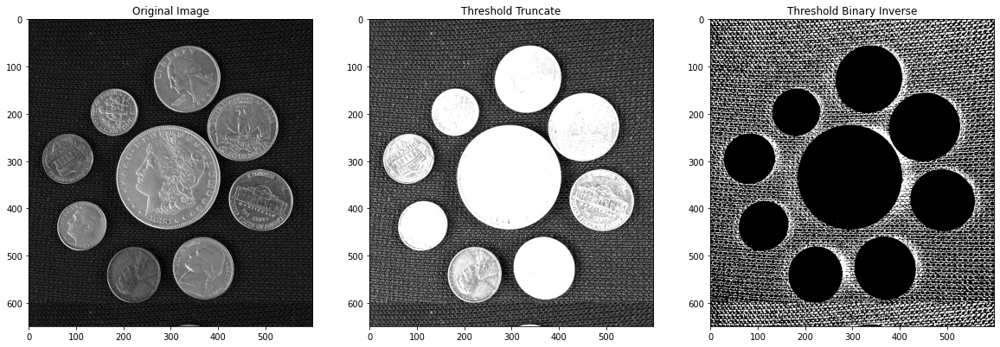

In [15]:
thresholdingActual(imageG, thresh, maxValue);

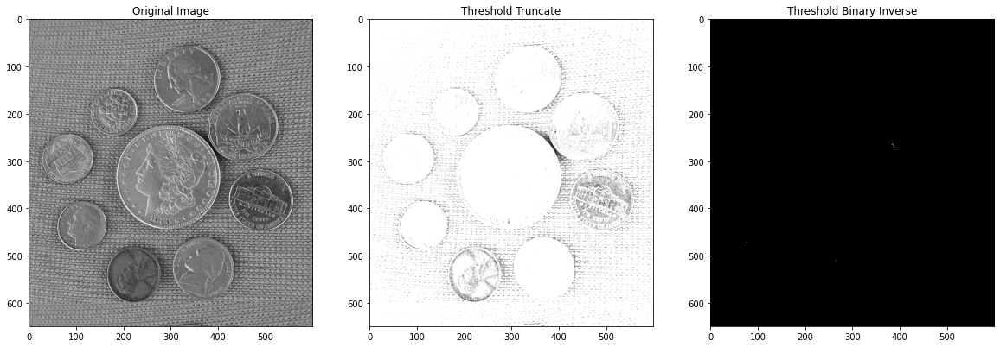

In [16]:
thresholdingActual(imageR, thresh, maxValue);

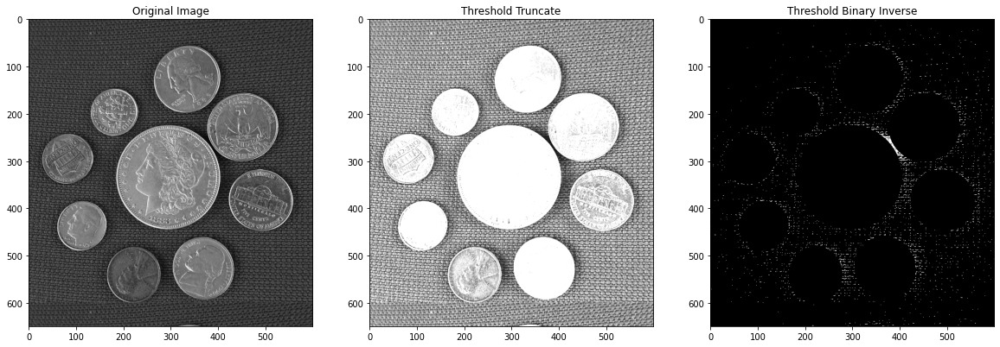

In [17]:
thresholdingActual(imageGray, thresh, maxValue);

### Observation
After observing the above images and the image shown in the video I infered that the first step should be to apply cv2.THRESH_TRUNC and then later cv2.THRESH_BINARY_INV on the output image of the previous step. I have created function `thresholdingActual(src, thresh, maxValue)` for the same.

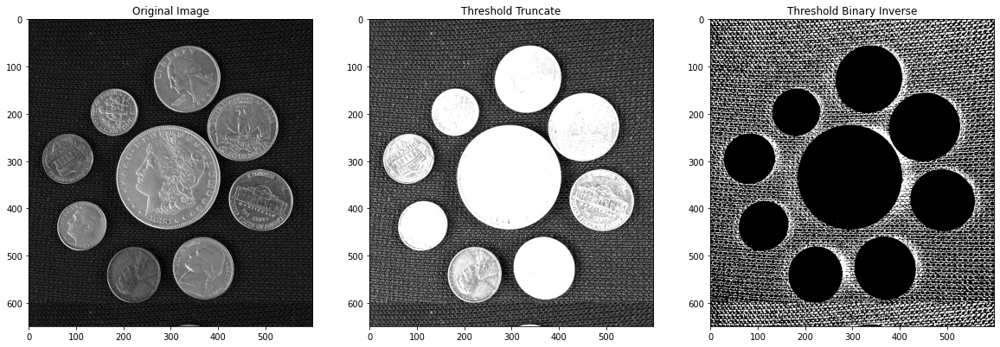

In [18]:
imageThresholded = thresholdingActual(imageG, thresh, maxValue);

Text(0.5, 1.0, 'Thresholded Image')

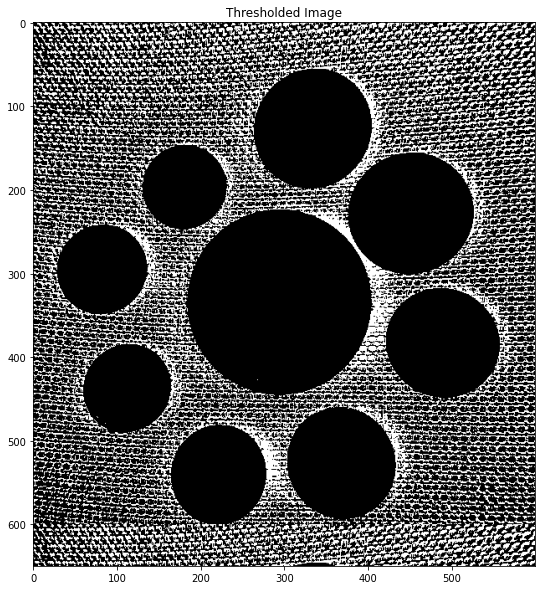

In [19]:
# Display the thresholded image
###
### YOUR CODE HERE
###
plt.imshow(imageThresholded); plt.title("Thresholded Image")

## <font style = "color:rgb(50,120,229)">Step 3.2: Perform morphological operations</font>

You will have to carry out this step with different kernel size, kernel shape and morphological operations to see which one (or more) suits you the most. Do not remove those intermediate images and make sure to document your findings.

In [20]:
def dilationTrials(src, kSize, kShape, iterations):
    kernel = cv2.getStructuringElement(kShape, kSize)
    image_dia = cv2.dilate(src, kernel, iterations = iterations)
    plt.figure(figsize = [15, 15])
    plt.subplot(121); plt.imshow(src); plt.title("Original Image")
    plt.subplot(122); plt.imshow(image_dia); plt.title("Dilated Image")
    return image_dia

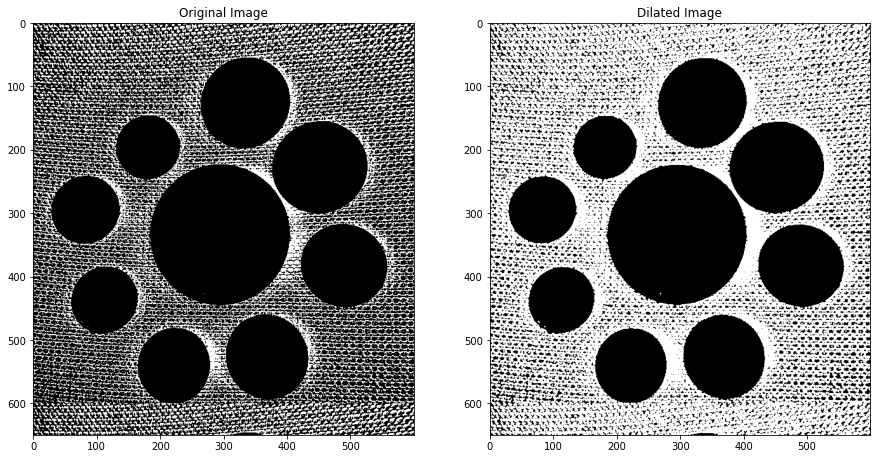

In [21]:
kSize = (3, 3)
kShape = cv2.MORPH_ELLIPSE
iterations = 1
dilationTrials(imageThresholded, kSize, kShape, iterations);

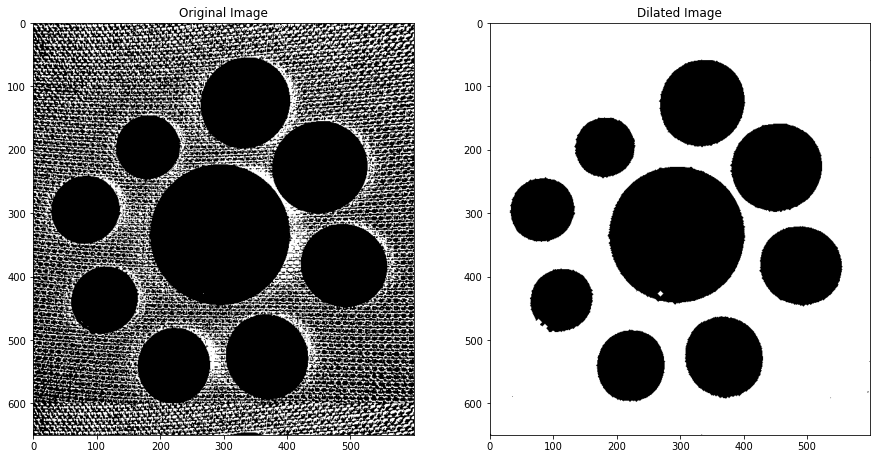

In [22]:
kSize = (3, 3)
kShape = cv2.MORPH_ELLIPSE
iterations = 4
dilationTrials(imageThresholded, kSize, kShape, iterations);

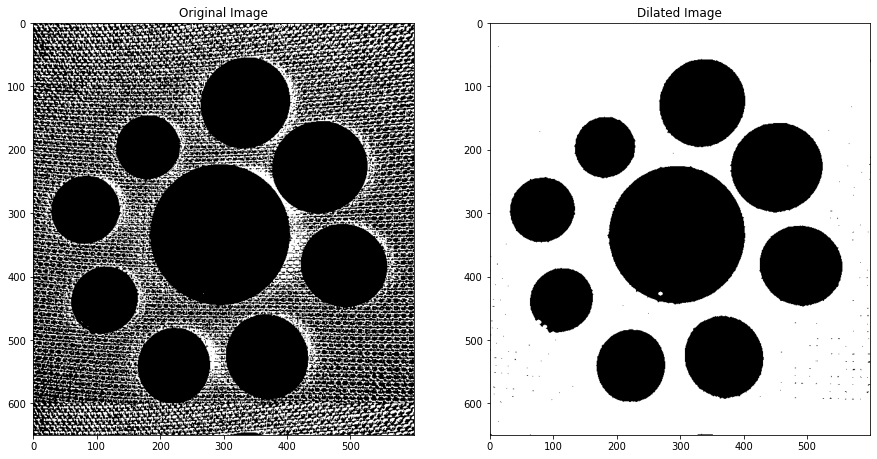

In [23]:
kSize = (7, 7)
kShape = cv2.MORPH_ELLIPSE
iterations = 1
dilationTrials(imageThresholded, kSize, kShape, iterations);

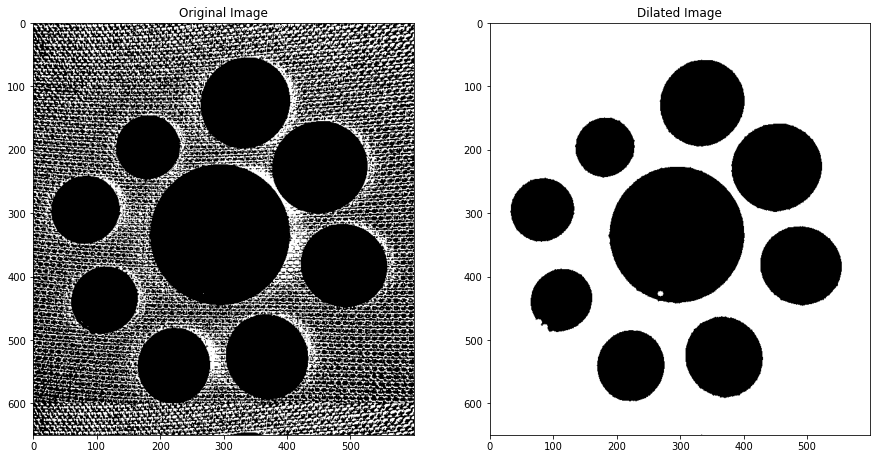

In [24]:
kSize = (9, 9)
kShape = cv2.MORPH_ELLIPSE
iterations = 1
dilationTrials(imageThresholded, kSize, kShape, iterations);

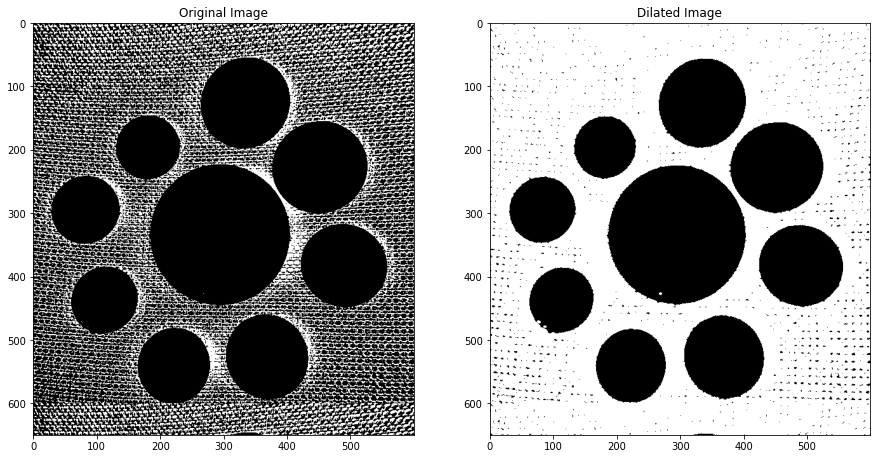

In [25]:
kSize = (5, 5)
kShape = cv2.MORPH_ELLIPSE
iterations = 1
dilationTrials(imageThresholded, kSize, kShape, iterations);

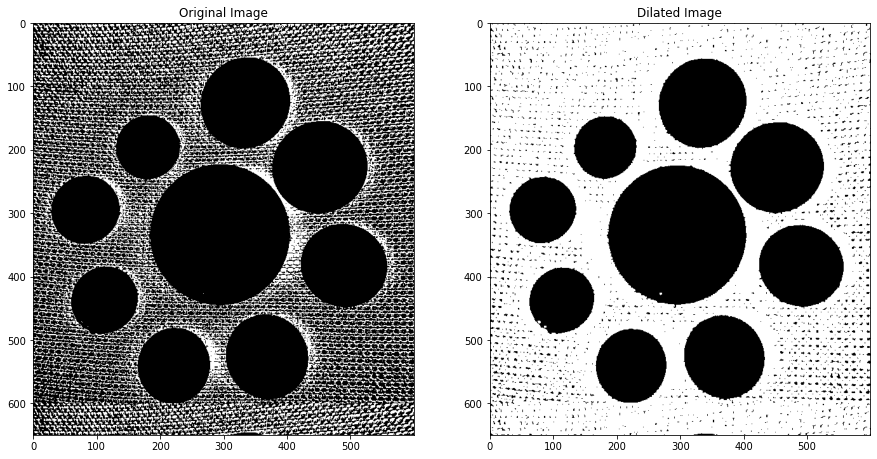

In [26]:
kSize = (4, 4)
kShape = cv2.MORPH_ELLIPSE
iterations = 1
dilationTrials(imageThresholded, kSize, kShape, iterations);

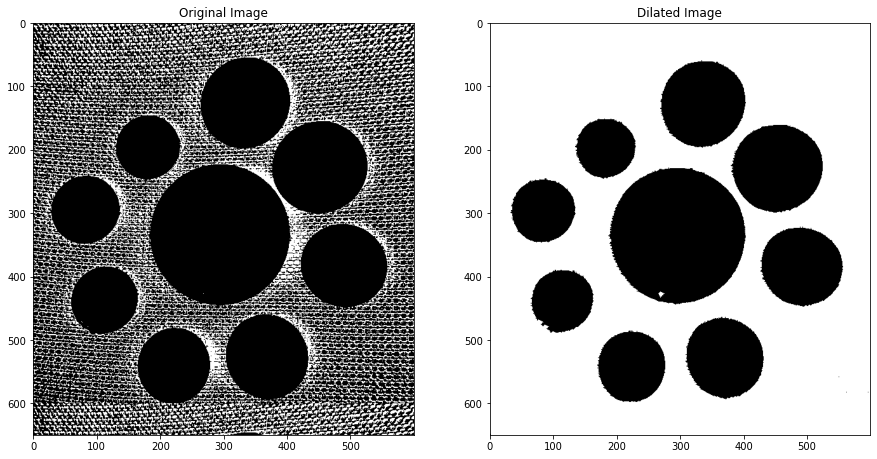

In [27]:
kSize = (4, 4)
kShape = cv2.MORPH_DILATE
iterations = 3
dilationTrials(imageThresholded, kSize, kShape, iterations);

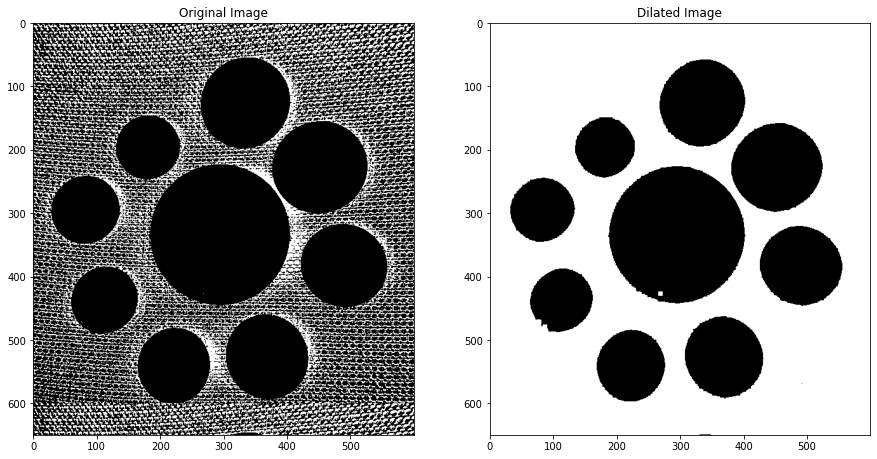

In [28]:
kSize = (3, 3)
kShape = cv2.MORPH_RECT
iterations = 3
dilationTrials(imageThresholded, kSize, kShape, iterations);

### Observation
As observed in the above plots, I can see that the best results are obtained for the following setting.


In [29]:
# Get structuring element/kernel which will be used for dilation
###
### YOUR CODE HERE
###


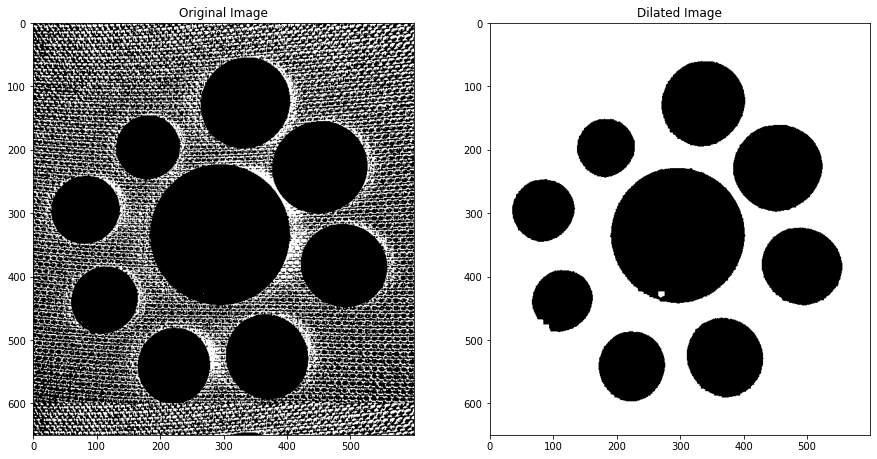

In [30]:
###
### YOUR CODE HERE
###
kSize = (4, 4)
kShape = cv2.MORPH_ELLIPSE
iterations = 3
imageDilated = dilationTrials(imageThresholded, kSize, kShape, iterations);

Text(0.5, 1.0, 'Image after dilation')

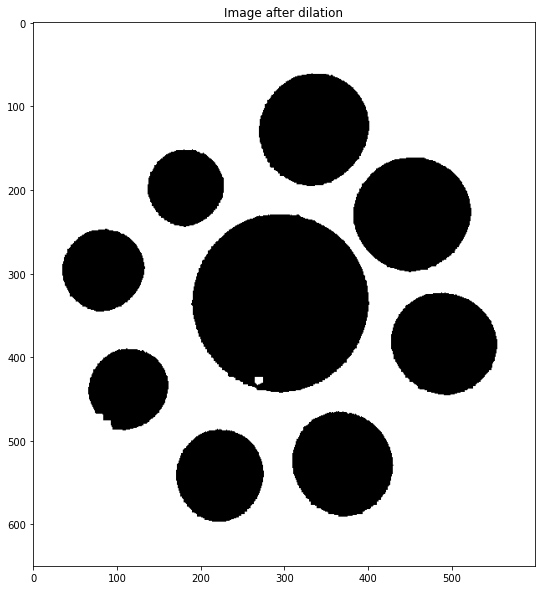

In [31]:
# Display all the images
# you have obtained in the intermediate steps
###
### YOUR CODE HERE
###
plt.imshow(imageDilated); plt.title("Image after dilation")

In [32]:
###
### YOUR CODE HERE
###
def erosionTrials(src, kSize, kShape, iterations):
    kernel = cv2.getStructuringElement(kShape, kSize)
    image_ero = cv2.erode(src, kernel, iterations = iterations)
    plt.figure(figsize = [15, 15])
    plt.subplot(121); plt.imshow(src); plt.title("Original Image")
    plt.subplot(122); plt.imshow(image_ero); plt.title("Eroded Image")
    return image_ero

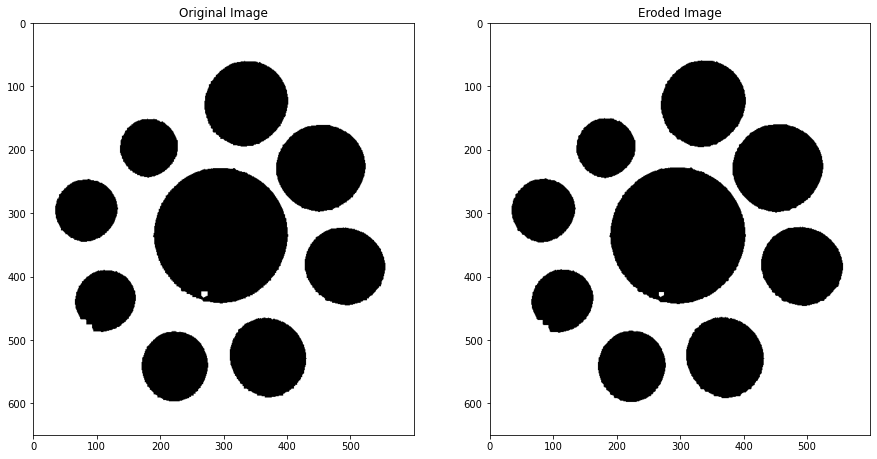

In [33]:
###
### YOUR CODE HERE
###
kSize = (3, 3)
kShape = cv2.MORPH_ELLIPSE
iterations = 1
erosionTrials(imageDilated, kSize, kShape, iterations);

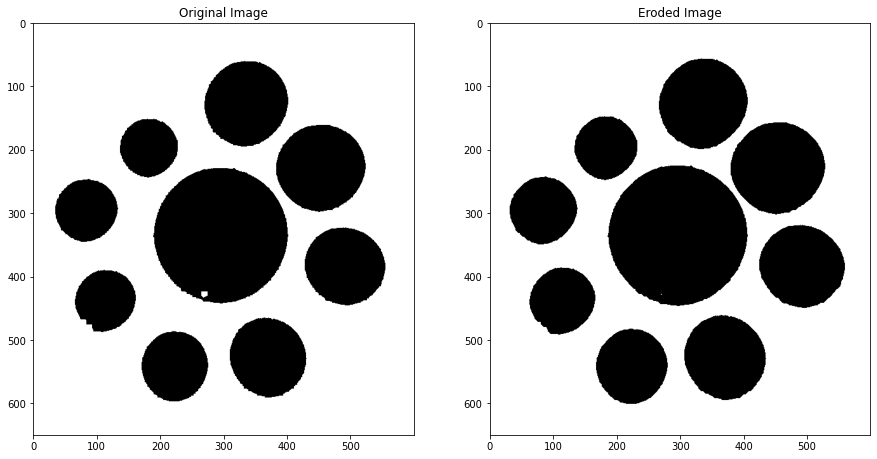

In [34]:
kSize = (3, 3)
kShape = cv2.MORPH_ELLIPSE
iterations = 4
erosionTrials(imageDilated, kSize, kShape, iterations);

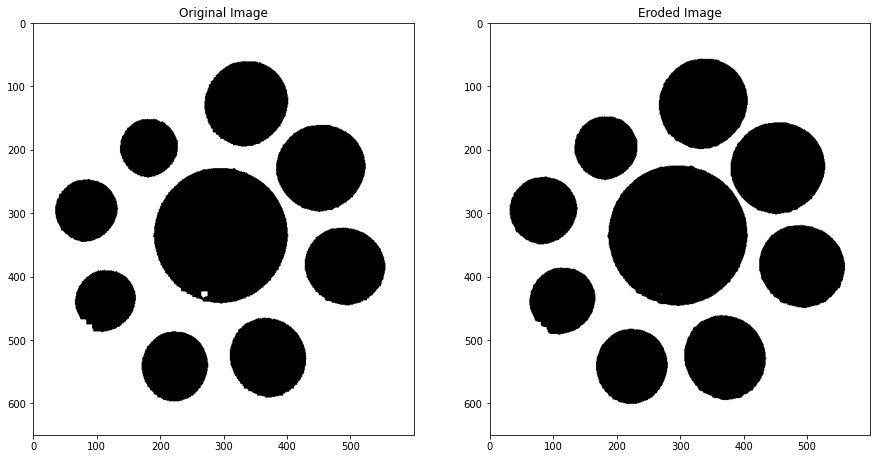

In [35]:
kSize = (9, 9)
kShape = cv2.MORPH_ELLIPSE
iterations = 1
erosionTrials(imageDilated, kSize, kShape, iterations);

### Observation
Lot of iterations were not required to achive the results shown in the video, since erosion is opposite to that of dilation, I decided to apply similar kernel size and shape for erosion and it worked properly

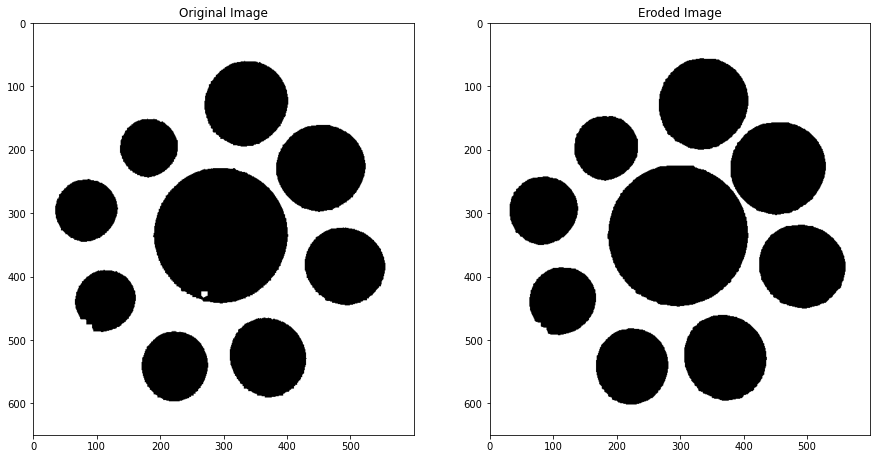

In [36]:
kSize = (10, 10)
kShape = cv2.MORPH_ELLIPSE
iterations = 1
imageEroded = erosionTrials(imageDilated, kSize, kShape, iterations);

Text(0.5, 1.0, 'Image after erosion')

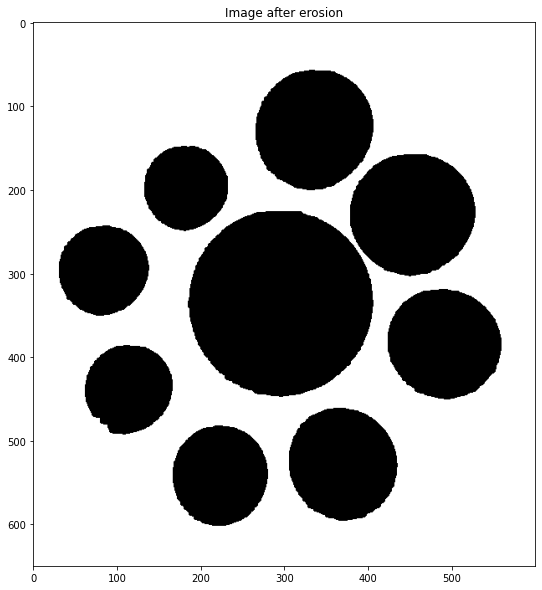

In [37]:
plt.imshow(imageEroded); plt.title("Image after erosion")

## <font style = "color:rgb(50,120,229)">Step 4.1: Create SimpleBlobDetector</font>

In [38]:
# Set up the SimpleBlobdetector with default parameters.
params = cv2.SimpleBlobDetector_Params()

params.blobColor = 0

params.minDistBetweenBlobs = 2

# Filter by Area.
params.filterByArea = False

# Filter by Circularity
params.filterByCircularity = True
params.minCircularity = 0.8

# Filter by Convexity
params.filterByConvexity = True
params.minConvexity = 0.8

# Filter by Inertia
params.filterByInertia =True
params.minInertiaRatio = 0.8

In [39]:
# Create SimpleBlobDetector
detector = cv2.SimpleBlobDetector_create(params)

## <font style = "color:rgb(50,120,229)">Step 4.2: Detect Coins</font>

### <font style = "color:rgb(8,133,37)">Hints</font>
Use **`detector.detect(image)`** to detect the blobs (coins). The output of the function is a list of **keypoints** where each keypoint is unique for each blob.

Print the number of coins detected as well.

In [40]:
# Detect blobs
###
### YOUR CODE HERE
###
keypoints = detector.detect(imageEroded);

In [41]:
# Print number of coins detected
###
### YOUR CODE HERE
###
print("Number of coins detected = {}".format(len(keypoints)))

Number of coins detected = 9


**Note that we were able to detect all 9 coins. So, that's your benchmark.**

## <font style = "color:rgb(50,120,229)">Step 4.3: Display the detected coins on original image</font>

Make sure to mark the center of the blobs as well. **Use only the functions discussed in Image Annotation section in Week 1**

### <font style = "color:rgb(8,133,37)">Hints</font>
You can extract the coordinates of the center and the diameter of a blob using **`k.pt`** and **`k.size`** where `k` is a keypoint.

In [42]:
# Mark coins using image annotation concepts we have studied so far
###
### YOUR CODE HERE
###
imageAnnotate = image.copy()
for k in keypoints:
    x, y = k.pt
    x = int(round(x))
    y = int(round(y))
    cv2.circle(imageAnnotate, (x, y), 5, (255, 0, 0), -1)
    diameter = k.size
    radius = int(round(diameter / 2))
    cv2.circle(imageAnnotate, (x, y), radius, (0, 255, 0), 2)

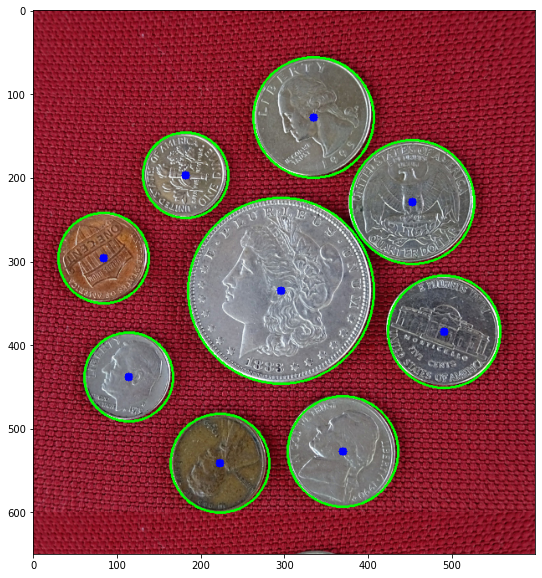

In [43]:
# Display the final image
###
### YOUR CODE HERE
###
plt.imshow(imageAnnotate[:, :, ::-1])

## <font style = "color:rgb(50,120,229)">Step 4.4: Perform Connected Component Analysis</font>

In the final step, perform Connected Component Analysis (CCA) on the binary image to find out the number of connected components. Do you think we can use CCA to calculate number of coins? Why/why not?

In [44]:
def displayConnectedComponents(im):
    imLabels = im
    # The following line finds the min and max pixel values
    # and their locations in an image.
    (minVal, maxVal, minLoc, maxLoc) = cv2.minMaxLoc(imLabels)
    # Normalize the image so the min value is 0 and max value is 255.
    imLabels = 255 * (imLabels - minVal)/(maxVal-minVal)
    # Convert image to 8-bits unsigned type
    imLabels = np.uint8(imLabels)
    # Apply a color map
    imColorMap = cv2.applyColorMap(imLabels, cv2.COLORMAP_JET)
    # Display colormapped labels
    plt.imshow(imColorMap[:,:,::-1])

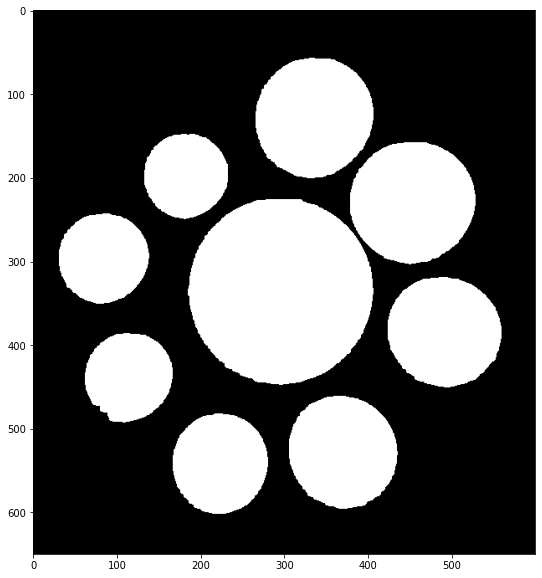

In [45]:
# Find connected components
###
### YOUR CODE HERE
###
th, imThresh = cv2.threshold(imageEroded, 80, 100, cv2.THRESH_BINARY_INV)
# imThresh = cv2.adaptiveThreshold(imageG ,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
plt.imshow(imThresh); plt.show()
_, imLabels = cv2.connectedComponents(imThresh)

In [46]:
# Print number of connected components detected
###
### YOUR CODE HERE
###
print("Number of connected components detected = {}".format(imLabels.max()))

Number of connected components detected = 9


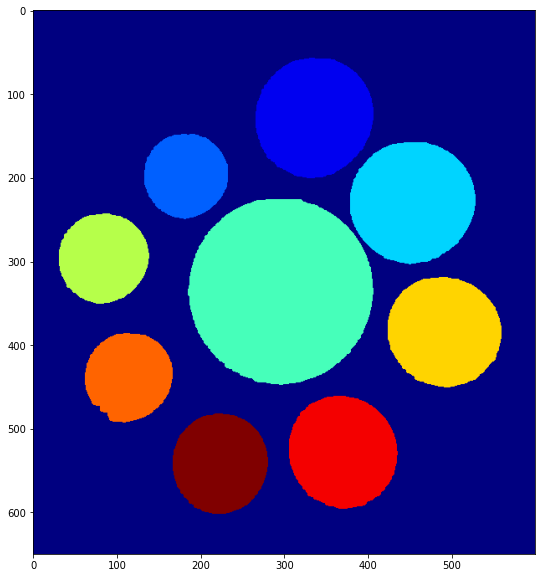

In [47]:
# Display connected components using displayConnectedComponents
# function
###
### YOUR CODE HERE
###
displayConnectedComponents(imLabels);

#### connectedComponentsWithStats() 
We cannot use simple `connectedComponents()` to filter out the small blob detected at the edge of the image, which is causing the number of coins to be detected to be as 10 instead of 9.

Using [`connectedComponentsWithStats()`](https://docs.opencv.org/3.4/d3/dc0/group__imgproc__shape.html#gaedef8c7340499ca391d459122e51bef5), the return value `stats` has the type [`ConnectedComponentsTypes`](https://docs.opencv.org/3.4/d3/dc0/group__imgproc__shape.html#gac7099124c0390051c6970a987e7dc5c5), the last column of this array indicates the total area (in pixels) of the connected component.

Number of connected components detected = 9


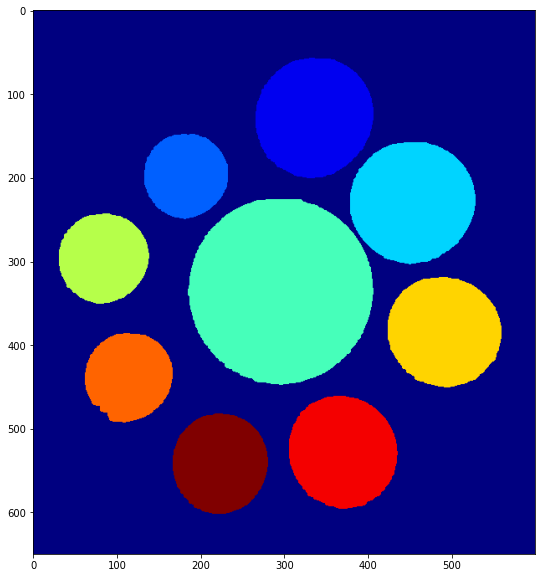

In [48]:
# Filtering out small connected components
nb_components, imLabels, stats, _ = cv2.connectedComponentsWithStats(imThresh);
displayConnectedComponents(imLabels);
print("Number of connected components detected = {}".format(imLabels.max()))

In [49]:
print(stats)
print(stats.size)
print(stats.dtype)
print(type(stats))
print(stats.shape)

[[     0      0    600    650 254165]
 [   266     57    141    144  15913]
 [   133    148    100    102   7984]
 [   379    158    150    146  17135]
 [   185    226    222    222  38470]
 [    31    243    108    108   9071]
 [   424    319    136    132  14062]
 [    62    386    105    107   8694]
 [   306    461    130    135  13739]
 [   167    482    114    120  10767]]
50
int32
<class 'numpy.ndarray'>
(10, 5)


In [50]:
# Zeroth row of stats is the background so removing it
# last column of stats is the total area in pixel so seperating it
sizes = stats[1:, -1]
print(sizes.shape)
print(sizes)

(9,)
[15913  7984 17135 38470  9071 14062  8694 13739 10767]


Number of connected components detected = 9


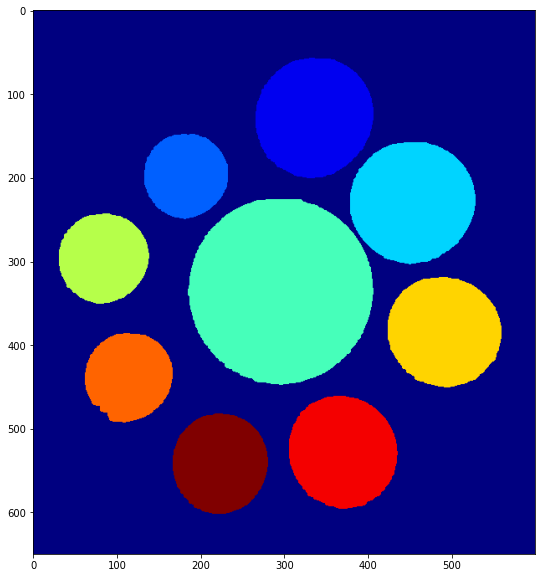

In [51]:
# As we can see above row number 10 is the smallest blob with size 33
# Filtering it out we get
imLabels[imLabels == 10] = 0
displayConnectedComponents(imLabels);
print("Number of connected components detected = {}".format(imLabels.max()))

## <font style = "color:rgb(50,120,229)">Step 4.5: Detect coins using Contour Detection</font>

In the final step, perform Contour Detection on the binary image to find out the number of coins.

In [52]:
# Find all contours in the image
###
### YOUR CODE HERE
###
def contoursTrials(imageBin, imageBGR, retMode):
    contours, heirarchy = cv2.findContours(imageBin, retMode, cv2.CHAIN_APPROX_SIMPLE)
    print("Number of contours found = {}".format(len(contours)))
    cv2.drawContours(imageBGR, contours, -1, (0, 0, 0), 5)
    plt.figure(figsize = [15, 15])
    plt.subplot(121); plt.imshow(imageBin); plt.title("Binary Image")
    plt.subplot(122); plt.imshow(imageBGR[:, :, ::-1]); plt.title("Image with contours")
    return contours

Number of contours found = 9


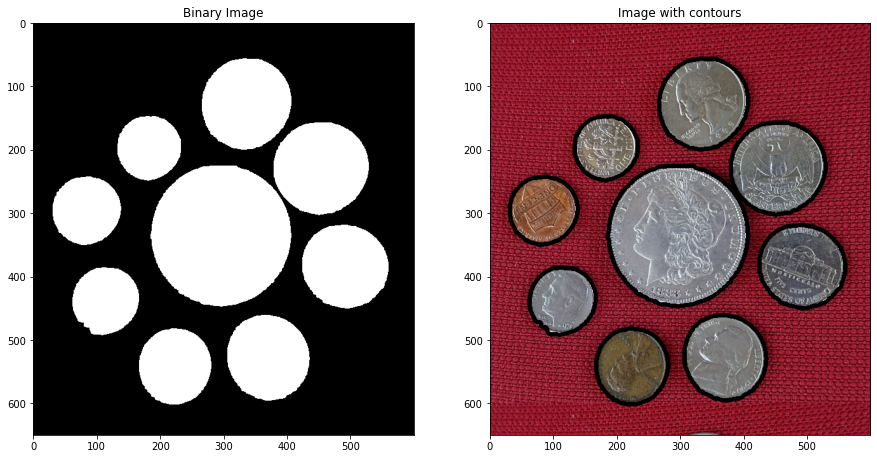

In [53]:
# Print the number of contours found
###
### YOUR CODE HERE
###
contoursTrials(imThresh, image.copy(), cv2.RETR_EXTERNAL);

In [54]:
# plt.imshow(image[:, :, ::-1]); plt.title("Original Image"); plt.show()

Number of contours found = 1


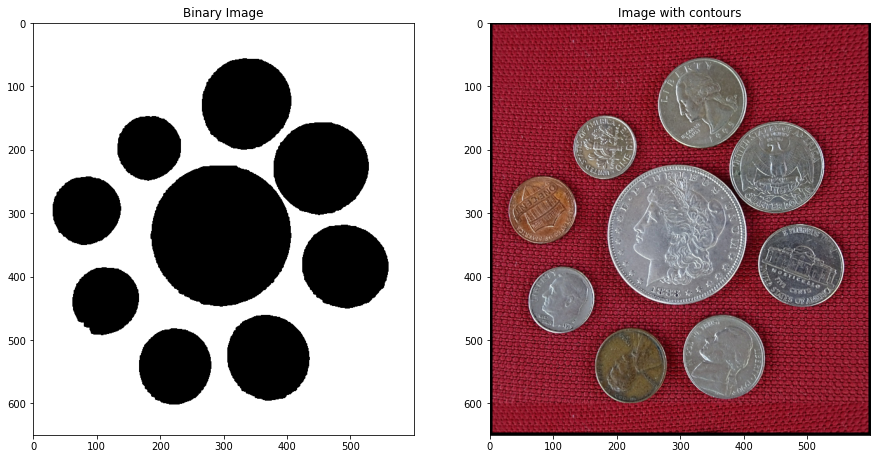

In [55]:
contoursTrials(imageEroded, image.copy(), cv2.RETR_EXTERNAL);

Number of contours found = 10


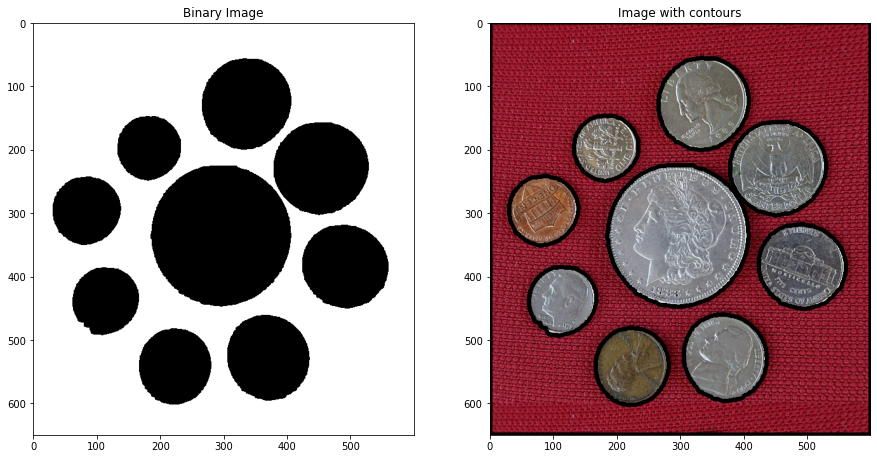

In [56]:
contoursTrials(imageEroded, image.copy(), cv2.RETR_LIST);

Number of contours found = 10


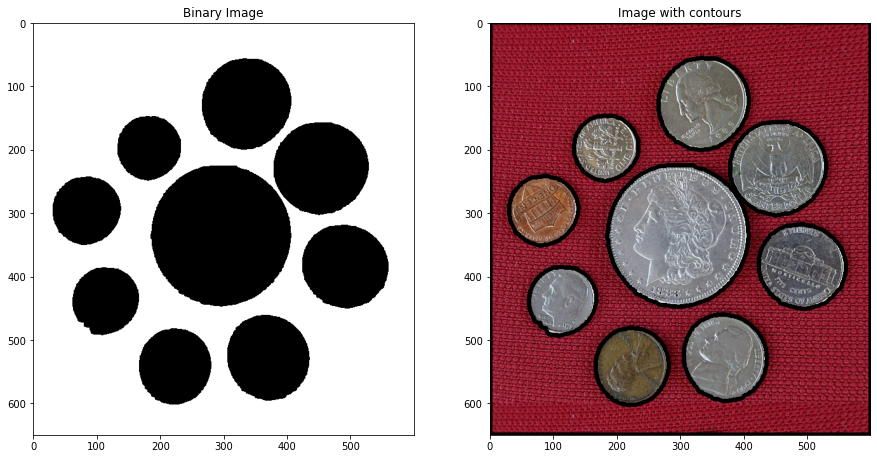

In [57]:
contoursTrials(imageEroded, image.copy(), cv2.RETR_CCOMP);

Number of contours found = 10


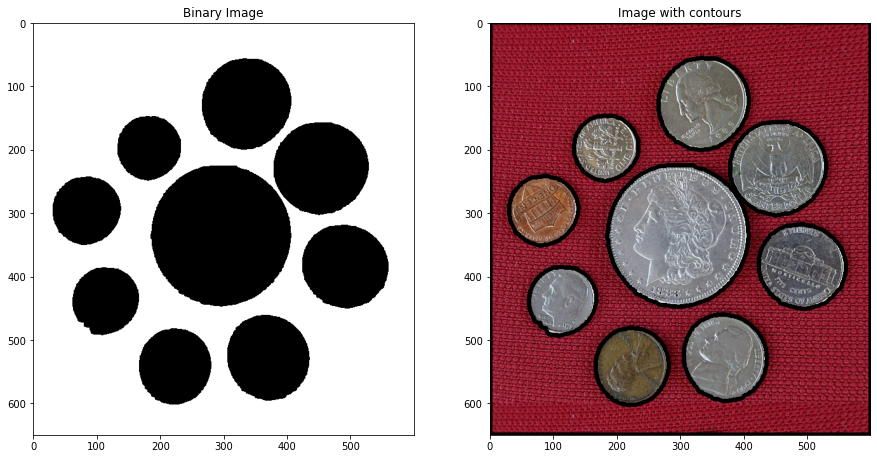

In [58]:
contoursTrials(imageEroded, image.copy(), cv2.RETR_TREE);

In [59]:
# Draw all contours
###
### YOUR CODE HERE
###


Let's only consider the outer contours.

In [60]:
# Remove the inner contours
# Display the result
###
### YOUR CODE HERE
###


So, we only need the inner contours. The easiest way to do that will be to remove the outer contour using area.

In [61]:
# Print area and perimeter of all contours
###
### YOUR CODE HERE
###


Number of contours found = 10
(10,)
Contour #0 has area = 388751.0 and perimeter = 2496.0
Contour #1 has area = 10937.0 and perimeter = 395.8477592468262
Contour #2 has area = 13932.5 and perimeter = 449.06096291542053
Contour #3 has area = 8851.0 and perimeter = 362.39191591739655
Contour #4 has area = 14256.0 and perimeter = 452.1320297718048
Contour #5 has area = 9225.5 and perimeter = 362.776692032814
Contour #6 has area = 38791.5 and perimeter = 747.3107422590256
Contour #7 has area = 17345.5 and perimeter = 494.65894293785095
Contour #8 has area = 8129.0 and perimeter = 340.877197265625
Contour #9 has area = 16120.0 and perimeter = 481.4457380771637
[False  True  True  True  True  True  True  True  True  True]
<class 'list'>
<class 'numpy.ndarray'>


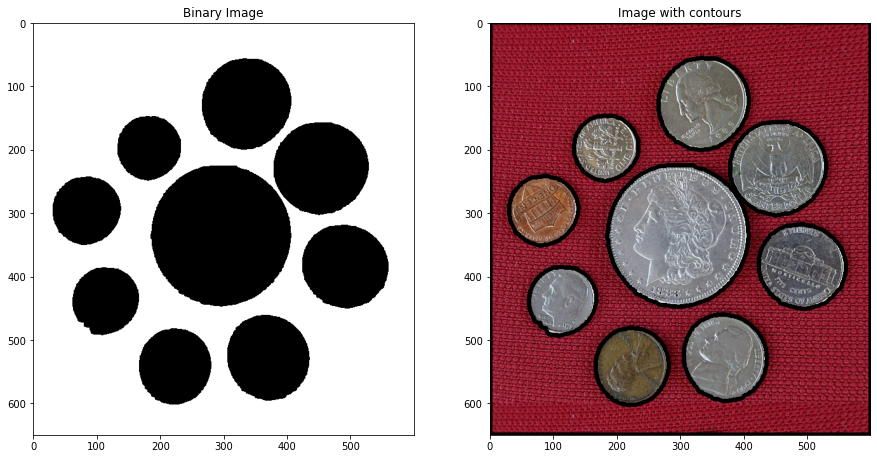

In [62]:
# Print maximum area of contour
# This will be the box that we want to remove
###
### YOUR CODE HERE
###
contours = contoursTrials(imageEroded, image.copy(), cv2.RETR_CCOMP);
areas_arr = np.zeros(len(contours))
print(areas_arr.shape)
for index, cnt in enumerate(contours):
    areas_arr[index] = cv2.contourArea(cnt)
    area = cv2.contourArea(cnt)
    perimeter = cv2.arcLength(cnt, True)
    print("Contour #{} has area = {} and perimeter = {}".format(index, area, perimeter))
print(areas_arr < 40000)
print(type(contours))
print(type(contours[1]))

In [63]:
contours = [cnt for cnt in contours if cv2.contourArea(cnt) < 40000] # list comprehension
for index, cnt in enumerate(contours):
    area = cv2.contourArea(cnt)
    perimeter = cv2.arcLength(cnt, True)
    print("Contour #{} has area = {} and perimeter = {}".format(index, area, perimeter))

Contour #0 has area = 10937.0 and perimeter = 395.8477592468262
Contour #1 has area = 13932.5 and perimeter = 449.06096291542053
Contour #2 has area = 8851.0 and perimeter = 362.39191591739655
Contour #3 has area = 14256.0 and perimeter = 452.1320297718048
Contour #4 has area = 9225.5 and perimeter = 362.776692032814
Contour #5 has area = 38791.5 and perimeter = 747.3107422590256
Contour #6 has area = 17345.5 and perimeter = 494.65894293785095
Contour #7 has area = 8129.0 and perimeter = 340.877197265625
Contour #8 has area = 16120.0 and perimeter = 481.4457380771637


In [64]:
# Remove this contour and plot others
###
### YOUR CODE HERE
###
def removeExternalContour(imageBin, imageBGR, retMode, maxArea):
    contours, heirarchy = cv2.findContours(imageBin, retMode, cv2.CHAIN_APPROX_SIMPLE)
    print("Number of contours found = {}".format(len(contours)))
    contours = [cnt for cnt in contours if cv2.contourArea(cnt) <  maxArea]
    print("Number of contours remaining = {}".format(len(contours)))

    for index, cnt in enumerate(contours):
        area = cv2.contourArea(cnt)
        perimeter = cv2.arcLength(cnt, True)
        print("Contour #{} has area = {} and perimeter = {}".format(index, area, perimeter))
        
        #fit circle
        ((x, y), radius) = cv2.minEnclosingCircle(cnt)
        cv2.circle(imageBGR, (int(x), int(y)), int(round(radius)), (255, 0, 0), 5)
        
        # plotting centroid
        M = cv2.moments(cnt)
        x = int(round(M["m10"]/ M["m00"]))
        y = int(round(M["m01"]/ M["m00"]))
        cv2.circle(imageBGR, (x,y), 10, (0, 0, 255), -1);
        
        # annotate
        cv2.putText(imageBGR, "{}".format(index + 1), (x+40, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2);
        
#     cv2.drawContours(imageBGR, contours, -1, (0, 255, 0), 5)
    
    plt.figure(figsize = [15, 15])
    plt.subplot(121); plt.imshow(imageBin); plt.title("Binary Image")
    plt.subplot(122); plt.imshow(imageBGR[:, :, ::-1]); plt.title("Image with contours")
    return contours

Number of contours found = 10
Number of contours remaining = 9
Contour #0 has area = 10937.0 and perimeter = 395.8477592468262
Contour #1 has area = 13932.5 and perimeter = 449.06096291542053
Contour #2 has area = 8851.0 and perimeter = 362.39191591739655
Contour #3 has area = 14256.0 and perimeter = 452.1320297718048
Contour #4 has area = 9225.5 and perimeter = 362.776692032814
Contour #5 has area = 38791.5 and perimeter = 747.3107422590256
Contour #6 has area = 17345.5 and perimeter = 494.65894293785095
Contour #7 has area = 8129.0 and perimeter = 340.877197265625
Contour #8 has area = 16120.0 and perimeter = 481.4457380771637


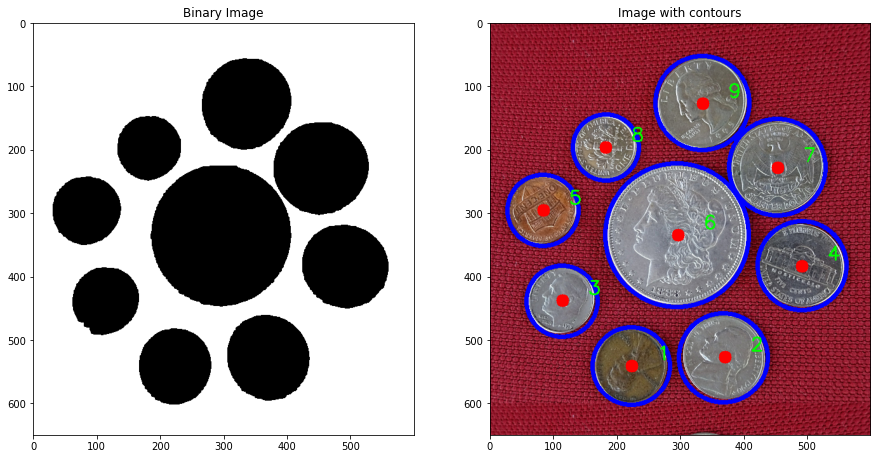

In [65]:
# Fit circles on coins
###
### YOUR CODE HERE
###
contours = removeExternalContour(imageEroded, image.copy(), cv2.RETR_CCOMP, 40000);

# <font style = "color:rgb(50,120,229)">Assignment Part - B</font>

**Follow the same steps as provided in Assignment Part - A**

## <font style = "color:rgb(50,120,229)"> Step 1: Read Image</font>

Text(0.5, 1.0, 'Original Image')

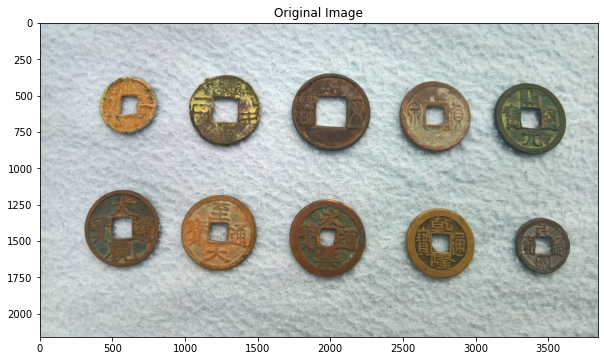

In [66]:
# Image path
imagePath = DATA_PATH + "images/CoinsB.png"
# Read image
# Store it in variable image
###
### YOUR CODE HERE
###
image = cv2.imread(imagePath)
imageCopy = image.copy()
plt.imshow(image[:,:,::-1]);
plt.title("Original Image")

## <font style = "color:rgb(50,120,229)">Step 2.1: Convert Image to Grayscale</font>

In [67]:
# Convert to grayscale
# Store in variable imageGray
###
### YOUR CODE HERE
###
imageGray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

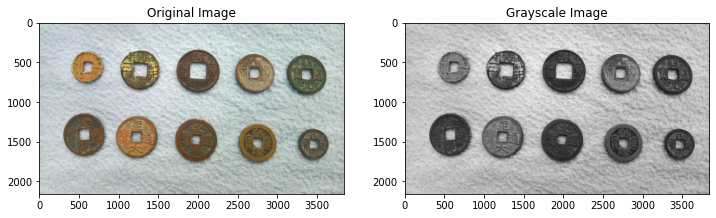

In [68]:
plt.figure(figsize=(12,12))
plt.subplot(121)
plt.imshow(image[:,:,::-1]);
plt.title("Original Image")
plt.subplot(122)
plt.imshow(imageGray);
plt.title("Grayscale Image");

## <font style = "color:rgb(50,120,229)">Step 2.2: Split Image into R,G,B Channels</font>

In [69]:
# Split cell into channels
# Variables are: imageB, imageG, imageR
###
### YOUR CODE HERE
###
imageB = image[:, :, 0]
imageG = image[:, :, 1]
imageR = image[:, :, 2]

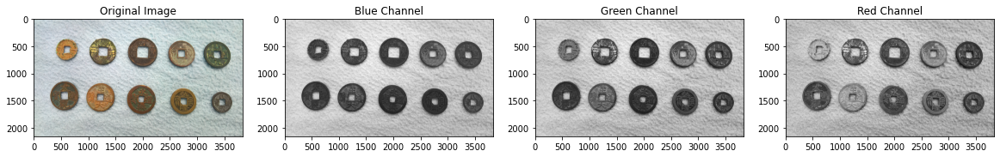

In [70]:
plt.figure(figsize=(20,12))
plt.subplot(141)
plt.imshow(image[:,:,::-1]);
plt.title("Original Image")
plt.subplot(142)
plt.imshow(imageB);
plt.title("Blue Channel")
plt.subplot(143)
plt.imshow(imageG);
plt.title("Green Channel")
plt.subplot(144)
plt.imshow(imageR);
plt.title("Red Channel");

## <font style = "color:rgb(50,120,229)">Step 3.1: Perform Thresholding</font>

You will have to carry out this step with different threshold values to see which one suits you the most. Do not remove those intermediate images and make sure to document your findings.

Threshold Value = 150, Max Value = 200


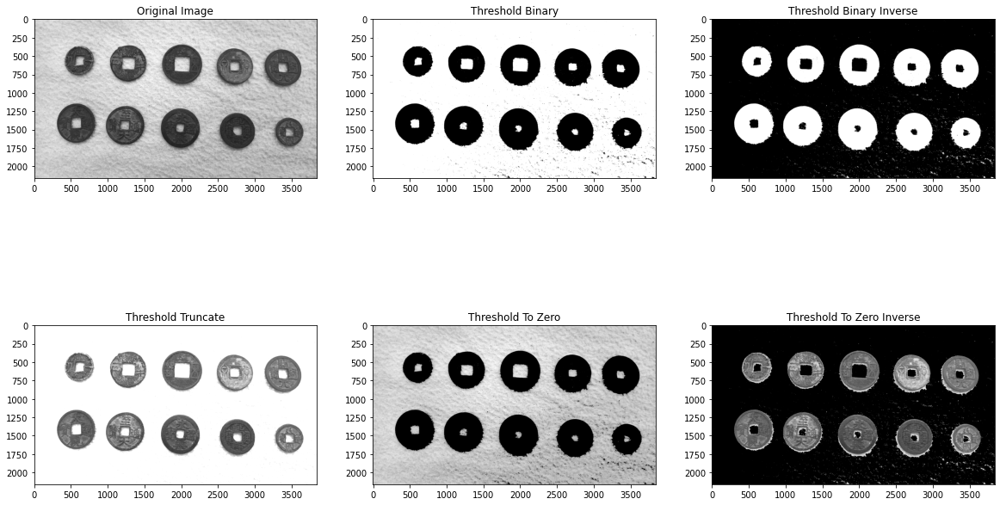

In [71]:
###
### YOUR CODE HERE
###
thresh = 150
maxValue = 200
thresholdingTrials(imageB, thresh, maxValue)

Threshold Value = 150, Max Value = 200


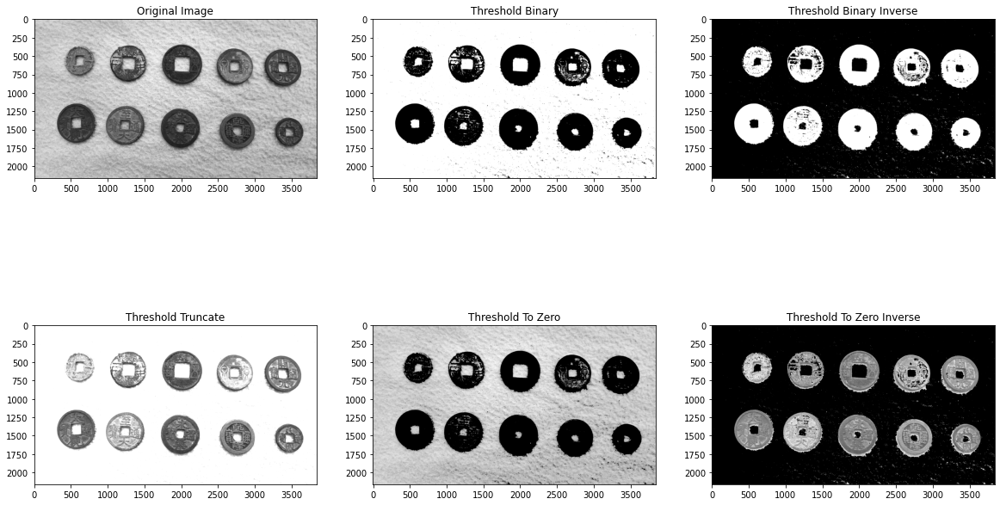

In [72]:
thresholdingTrials(imageG, thresh, maxValue)

Threshold Value = 150, Max Value = 200


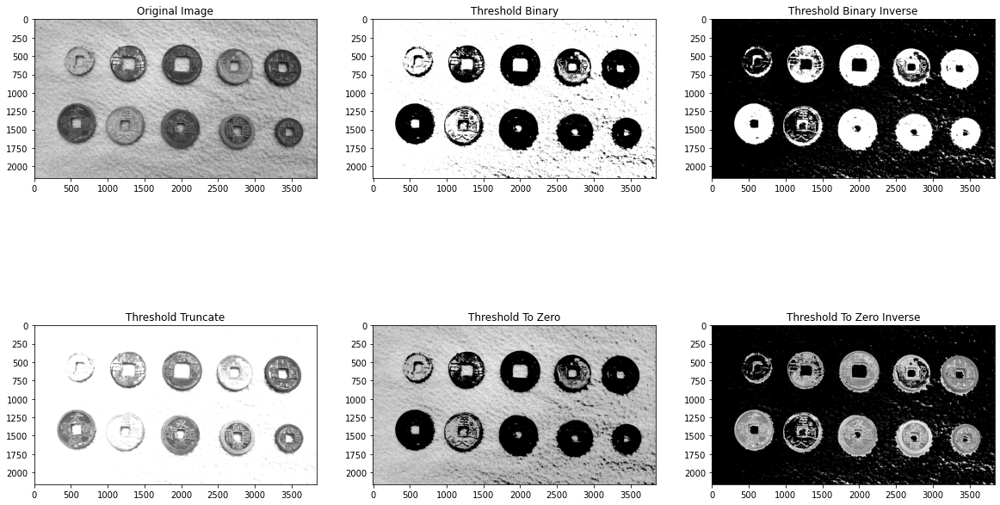

In [73]:
thresholdingTrials(imageR, thresh, maxValue)

Threshold Value = 150, Max Value = 200


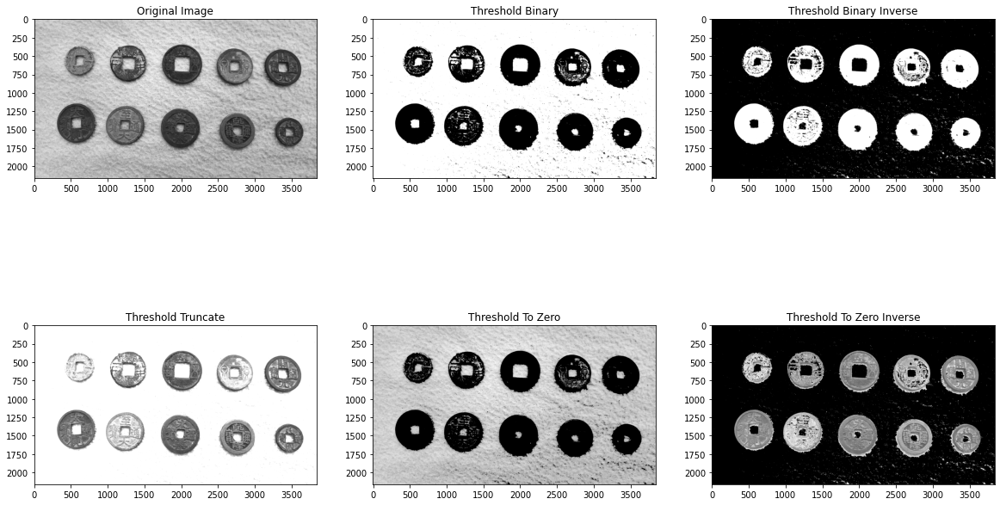

In [74]:
thresholdingTrials(imageGray, thresh, maxValue)

In [75]:
def thresholdingActualB(src, thresh, maxValue):
    # thresholding truncate
    th, dst_bin = cv2.threshold(src, thresh, maxValue, cv2.THRESH_BINARY)

#     # threshold binary inverse
#     th, dst_bin_inv = cv2.threshold(dst_trunc, 20, 100, cv2.THRESH_BINARY_INV)
    
    plt.figure(figsize=[20,12])
    plt.subplot(131);plt.imshow(src);plt.title("Original Image");
    plt.subplot(132);plt.imshow(dst_bin);plt.title("Threshold Truncate");
#     plt.subplot(133);plt.imshow(dst_bin_inv);plt.title("Threshold Binary Inverse");
    
    return dst_bin

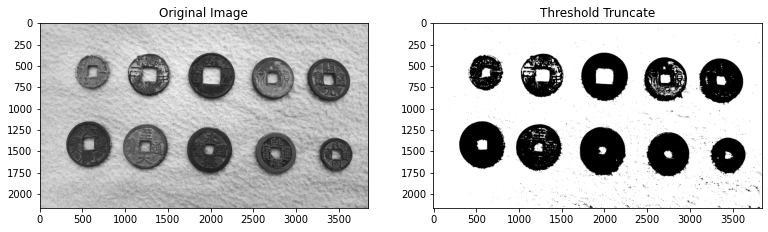

In [76]:
thresholdingActualB(imageG, thresh, maxValue);

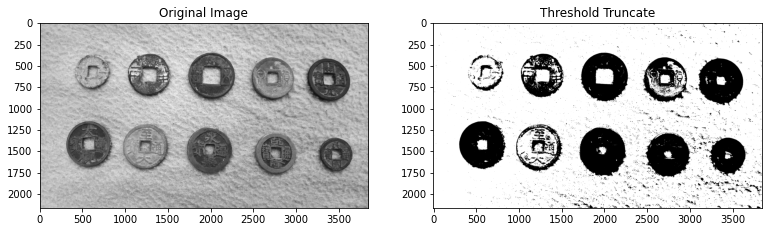

In [77]:
thresholdingActualB(imageR, thresh, maxValue);

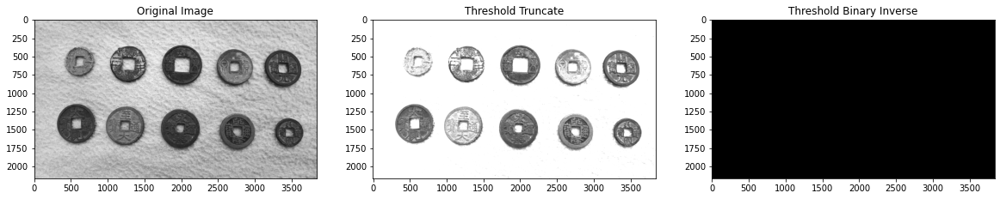

In [78]:
thresholdingActual(imageGray, thresh, maxValue);

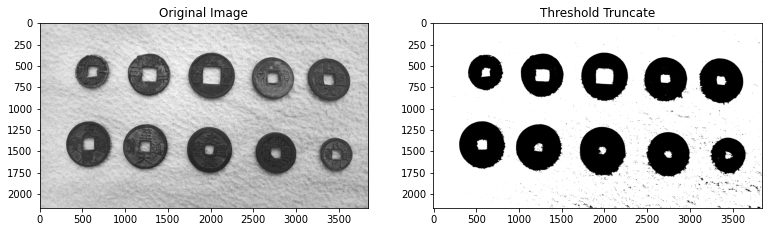

In [79]:
imageThresholded = thresholdingActualB(imageB, thresh, maxValue);

Text(0.5, 1.0, 'Thresholded Image')

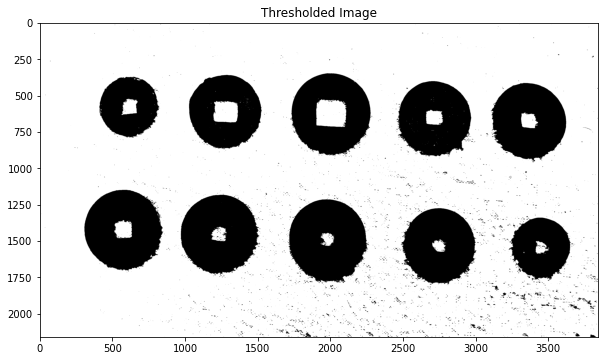

In [80]:
# Display image using matplotlib
###
### YOUR CODE HERE
###
plt.imshow(imageThresholded); plt.title("Thresholded Image")

## <font style = "color:rgb(50,120,229)">Step 3.2: Perform morphological operations</font>

You will have to carry out this step with different kernel size, kernel shape and morphological operations to see which one (or more) suits you the most. Do not remove those intermediate images and make sure to document your findings.

In [81]:
def openingTrials(src, openingSize, kShape, iterations):
    element = cv2.getStructuringElement(kShape, 
                                   (2 * openingSize + 1, 2 * openingSize + 1),
                                   (openingSize, openingSize))
    image_open = cv2.morphologyEx(src, cv2.MORPH_OPEN, element, iterations = iterations)
    
    plt.figure(figsize = [15, 15])
    plt.subplot(121); plt.imshow(src); plt.title("Original Image")
    plt.subplot(122); plt.imshow(image_open); plt.title("Image after opening")
    return image_open

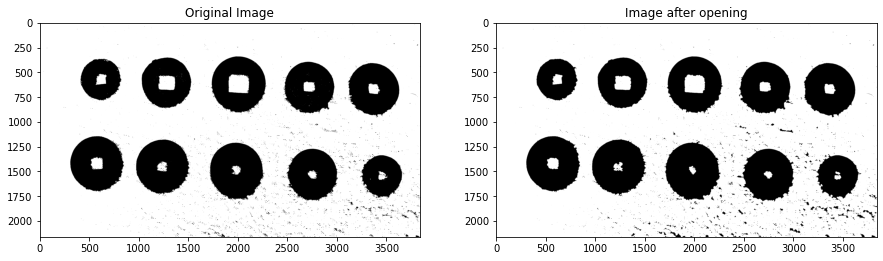

In [82]:
###
### YOUR CODE HERE
###
openingSize = 6
kShape = cv2.MORPH_ELLIPSE
iterations = 1
imageOpened = openingTrials(imageThresholded, openingSize, kShape, iterations);

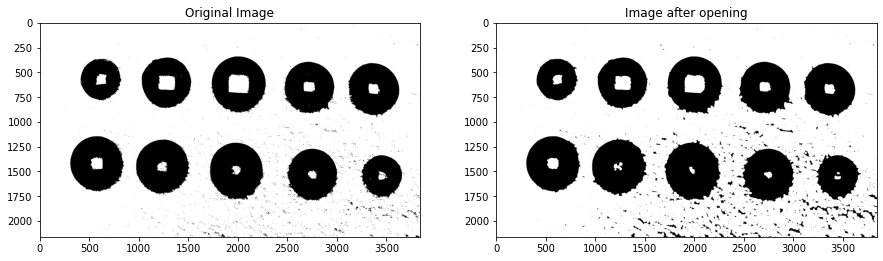

In [83]:
###
### YOUR CODE HERE
###
openingSize = 10
kShape = cv2.MORPH_ELLIPSE
iterations = 1
imageOpened = openingTrials(imageThresholded, openingSize, kShape, iterations);

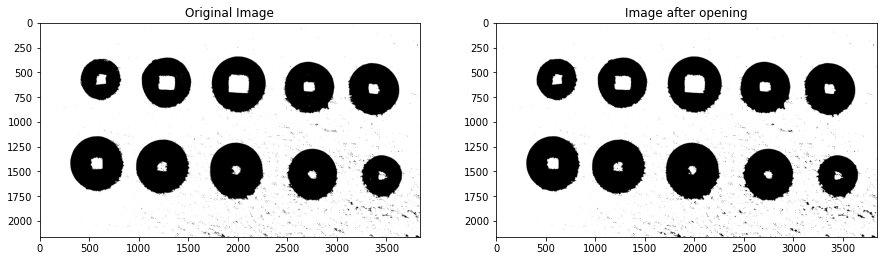

In [84]:
openingSize = 3
kShape = cv2.MORPH_ELLIPSE
iterations = 1
imageOpened = openingTrials(imageThresholded, openingSize, kShape, iterations);

Text(0.5, 1.0, 'Opened Image')

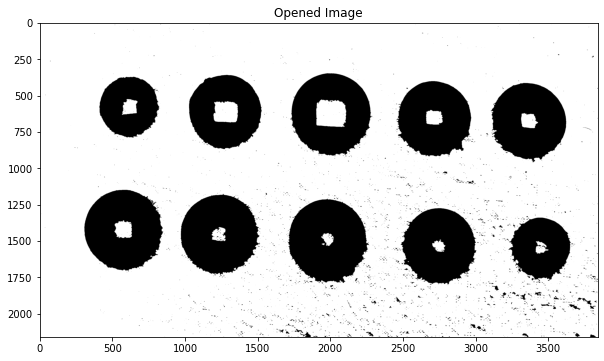

In [85]:
###
### YOUR CODE HERE
###
plt.imshow(imageOpened); plt.title("Opened Image")

In [86]:
###
### YOUR CODE HERE
###
def closingTrials(src, closingSize, kShape, iterations):
    element = cv2.getStructuringElement(kShape, 
                                   (2 * closingSize + 1, 2 * closingSize + 1),
                                   (closingSize, closingSize))
    image_close = cv2.morphologyEx(src, cv2.MORPH_CLOSE, element, iterations = iterations)
    
    plt.figure(figsize = [15, 15])
    plt.subplot(121); plt.imshow(src); plt.title("Original Image")
    plt.subplot(122); plt.imshow(image_close); plt.title("Image after closing")
    return image_close

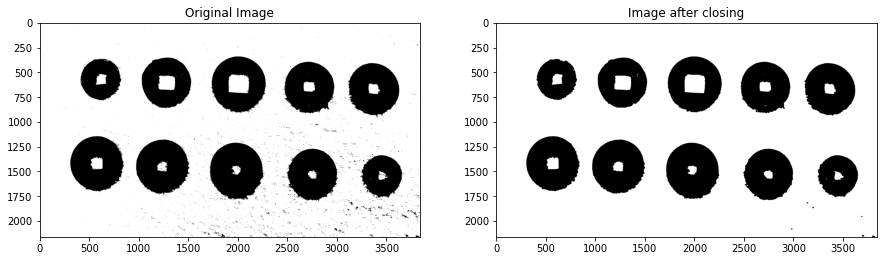

In [87]:
###
### YOUR CODE HERE
###
closingSize = 6
kShape = cv2.MORPH_ELLIPSE
iterations = 1
imageClosed = closingTrials(imageThresholded, closingSize, kShape, iterations);

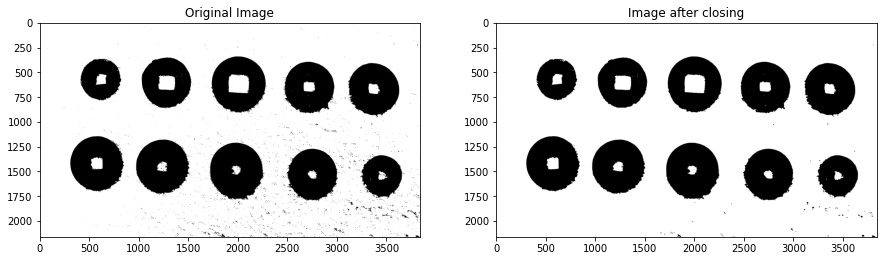

In [88]:
closingSize = 3
kShape = cv2.MORPH_ELLIPSE
iterations = 1
imageClosed = closingTrials(imageThresholded, closingSize, kShape, iterations);

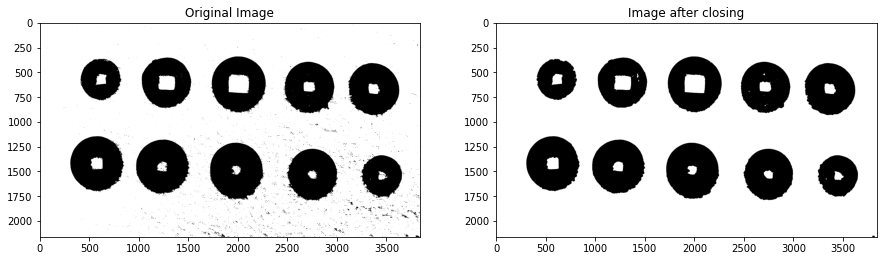

In [89]:
###
### YOUR CODE HERE
###
closingSize = 10
kShape = cv2.MORPH_ELLIPSE
iterations = 1
imageClosed = closingTrials(imageThresholded, closingSize, kShape, iterations);

Text(0.5, 1.0, 'Closed Image')

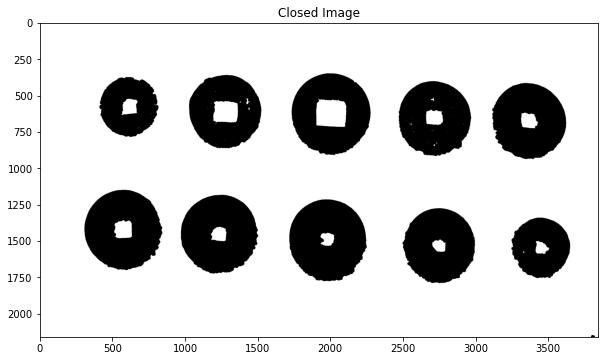

In [90]:
###
### YOUR CODE HERE
###
plt.imshow(imageClosed); plt.title("Closed Image")

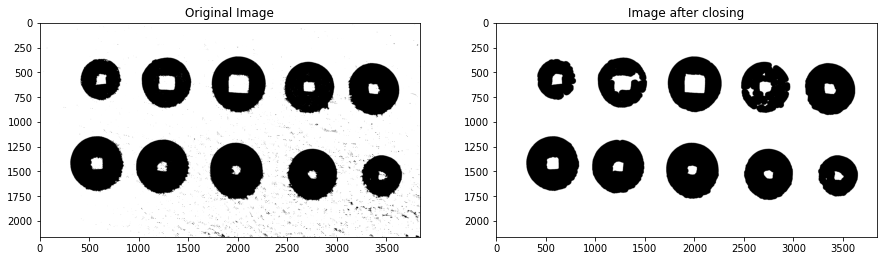

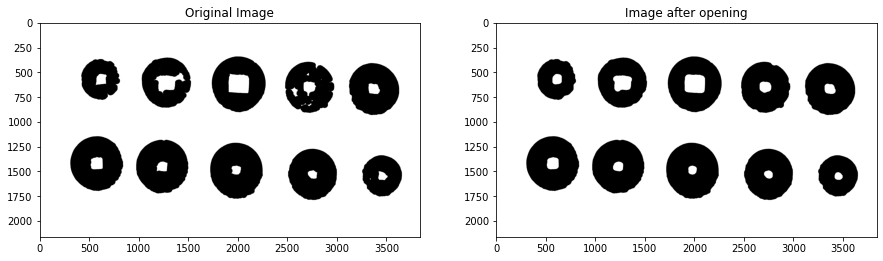

In [91]:
###
### YOUR CODE HERE
###
closingSize = 10
kShape = cv2.MORPH_ELLIPSE
iterations = 3
imageClosed = closingTrials(imageThresholded, closingSize, kShape, iterations);

openingSize = 10
kShape = cv2.MORPH_ELLIPSE
iterations = 3
imageClosedOpened = openingTrials(imageClosed, openingSize, kShape, iterations);

Text(0.5, 1.0, 'Image after closing and then opening')

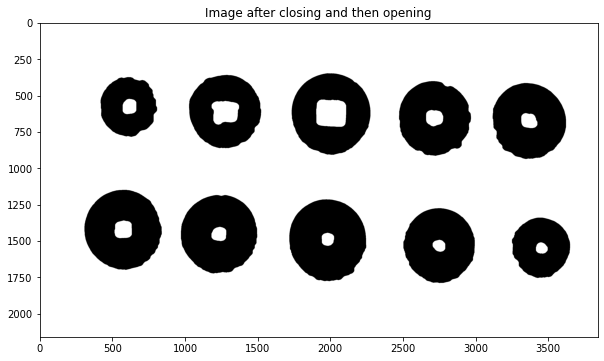

In [92]:
###
### YOUR CODE HERE
###
plt.imshow(imageClosedOpened); plt.title("Image after closing and then opening")

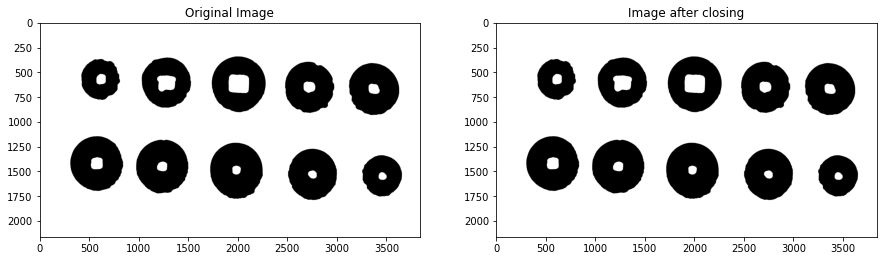

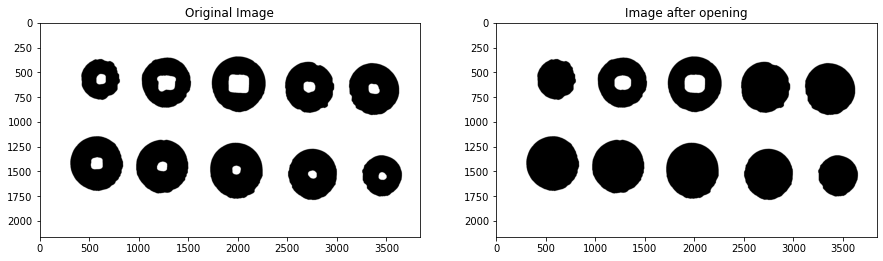

In [93]:
###
### YOUR CODE HERE
###
closingSize = 3
kShape = cv2.MORPH_ELLIPSE
iterations = 10
imageClosed = closingTrials(imageClosedOpened, closingSize, kShape, iterations);

openingSize = 10
kShape = cv2.MORPH_ELLIPSE
iterations = 6
imageClosedOpened = openingTrials(imageClosed, openingSize, kShape, iterations);

Text(0.5, 1.0, 'Image after closing and then opening')

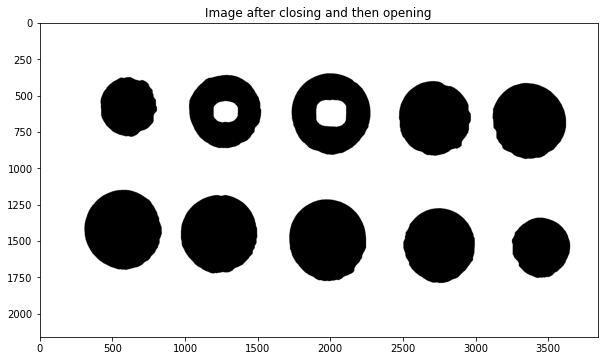

In [94]:
###
### YOUR CODE HERE
###
plt.imshow(imageClosedOpened); plt.title("Image after closing and then opening")

In [95]:
###
### YOUR CODE HERE
###
imageBIN = imageClosedOpened.copy()
print(np.max(imageBIN))
print(np.min(imageBIN))
imageBIN_INV = cv2.bitwise_not(imageBIN);

200
0


Text(0.5, 1.0, 'Image after closing and then opening')

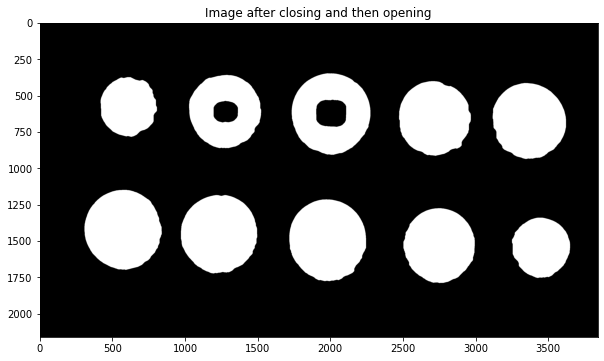

In [96]:
###
### YOUR CODE HERE
###
plt.imshow(imageBIN_INV); plt.title("Image after closing and then opening")

In [97]:
###
### YOUR CODE HERE
###
print(np.max(imageBIN_INV))
print(np.min(imageBIN_INV))

255
55


Text(0.5, 1.0, 'Image after closing and then opening')

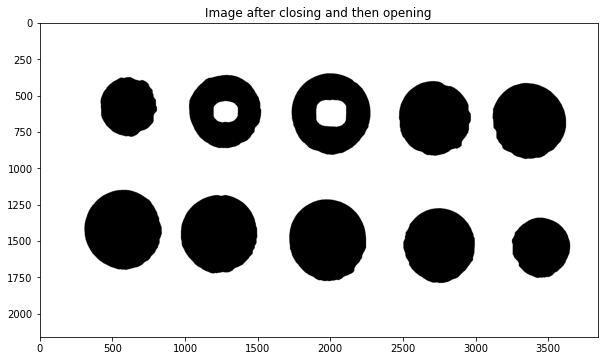

In [98]:
###
### YOUR CODE HERE
###
plt.imshow(imageClosedOpened); plt.title("Image after closing and then opening")

In [99]:
###
### YOUR CODE HERE
###


In [100]:
###
### YOUR CODE HERE
###


## <font style = "color:rgb(50,120,229)">Step 4.1: Create SimpleBlobDetector</font>

In [101]:
# Set up the SimpleBlobdetector with default parameters.
params = cv2.SimpleBlobDetector_Params()

params.blobColor = 255

params.minDistBetweenBlobs = 200

# Filter by Area.
params.filterByArea = False
params.minArea = 1

# Filter by Circularity
params.filterByCircularity = False
params.minCircularity = 0.1

# Filter by Convexity
params.filterByConvexity = False
params.minConvexity = 0.1

# Filter by Inertia
params.filterByInertia =False
params.minInertiaRatio = 0.1

In [102]:
# Create SimpleBlobDetector
detector = cv2.SimpleBlobDetector_create(params)


## <font style = "color:rgb(50,120,229)">Step 4.2: Detect Coins</font>

### <font style = "color:rgb(8,133,37)">Hints</font>
Use **`detector.detect(image)`** to detect the blobs (coins). The output of the function is a list of **keypoints** where each keypoint is unique for each blob.

Print the number of coins detected as well.

In [103]:
# Detect blobs
###
### YOUR CODE HERE
###
keypoints = detector.detect(imageBIN_INV);
print("Number of coins detected = {}".format(len(keypoints)))

Number of coins detected = 8


## <font style = "color:rgb(50,120,229)">Step 4.3: Display the detected coins on original image</font>

Make sure to mark the center of the blobs as well. **Use only the functions discussed in Image Annotation section in Week 1**

### <font style = "color:rgb(8,133,37)">Hints</font>
You can extract the coordinates of the center and the diameter of a blob using **`k.pt`** and **`k.size`** where `k` is a keypoint.

In [104]:
###
### YOUR CODE HERE
###
imageAnnotate = image.copy()
for k in keypoints:
    x, y = k.pt
    x = int(round(x))
    y = int(round(y))
    cv2.circle(imageAnnotate, (x, y), 20, (255, 0, 0), -1)
    diameter = k.size
    radius = int(round(diameter / 2))
    cv2.circle(imageAnnotate, (x, y), radius, (0, 255, 0), 30)

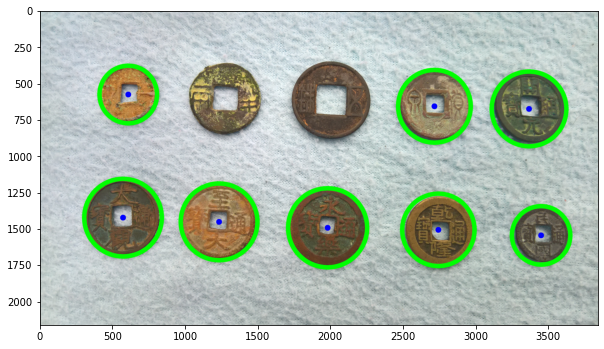

In [105]:
###
### YOUR CODE HERE
###
plt.imshow(imageAnnotate[:, :, ::-1])

In [106]:
###
### YOUR CODE HERE
###


**Note that we were able to detect 8 coins. So, that's your benchmark.**

## <font style = "color:rgb(50,120,229)">Step 4.4: Perform Connected Component Analysis</font>

Now, let's perform Connected Component Analysis (CCA) on the binary image to find out the number of connected components. Do you think we can use CCA to calculate number of coins? Why/why not?

Number of connected components detected = 10


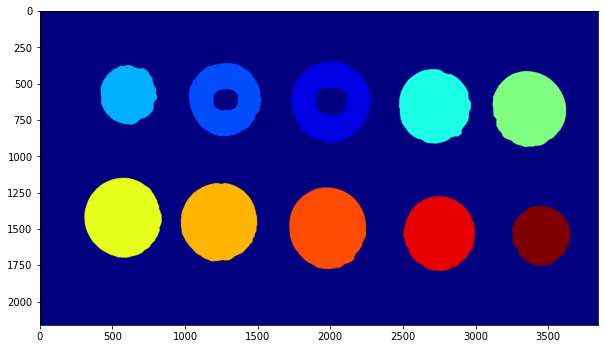

In [107]:
###
### YOUR CODE HERE
###
th, imThresh = cv2.threshold(imageBIN_INV, 80, 200, cv2.THRESH_BINARY)
nb_components, imLabels, stats, _ = cv2.connectedComponentsWithStats(imThresh);
displayConnectedComponents(imLabels);
print("Number of connected components detected = {}".format(imLabels.max()))

In [108]:
###
### YOUR CODE HERE
###


In [109]:
###
### YOUR CODE HERE
###


## <font style = "color:rgb(50,120,229)">Step 4.5: Detect coins using Contour Detection</font>

In the final step, perform Contour Detection on the binary image to find out the number of coins.

In [110]:
def contoursTrialsB(imageBin, imageBGR, retMode):
    contours, heirarchy = cv2.findContours(imageBin, retMode, cv2.CHAIN_APPROX_SIMPLE)
    print("Number of contours found = {}".format(len(contours)))
    cv2.drawContours(imageBGR, contours, -1, (0, 0, 0), 50)
    plt.figure(figsize = [15, 15])
    plt.subplot(121); plt.imshow(imageBin); plt.title("Binary Image")
    plt.subplot(122); plt.imshow(imageBGR[:, :, ::-1]); plt.title("Image with contours")
    return contours

In [ ]:
# Find all contours in the image
###
### YOUR CODE HERE
###
contours = contoursTrialsB(imThresh, image.copy(), cv2.RETR_EXTERNAL);
areas_arr = np.zeros(len(contours))
print(areas_arr.shape)
for index, cnt in enumerate(contours):
    areas_arr[index] = cv2.contourArea(cnt)
    area = cv2.contourArea(cnt)
    perimeter = cv2.arcLength(cnt, True)
    print("Contour #{} has area = {} and perimeter = {}".format(index, area, perimeter))

Number of contours found = 10
(10,)
Contour #0 has area = 126587.0 and perimeter = 1342.0773289203644
Contour #1 has area = 195157.0 and perimeter = 1662.3271141052246
Contour #2 has area = 232072.0 and perimeter = 1818.8956570625305
Contour #3 has area = 220893.5 and perimeter = 1773.9667241573334
Contour #4 has area = 225415.0 and perimeter = 1794.2093654870987
Contour #5 has area = 205200.0 and perimeter = 1711.9839717149734
Contour #6 has area = 196690.0 and perimeter = 1688.7291333675385
Contour #7 has area = 122402.0 and perimeter = 1336.4793561697006
Contour #8 has area = 194104.0 and perimeter = 1663.841831445694
Contour #9 has area = 235558.0 and perimeter = 1828.008349776268


In [ ]:
print(np.max(imThresh))
print(np.min(imThresh))
print(imThresh.dtype)
print(np.max(imageBIN))
print(np.min(imageBIN))
print(imageBIN.dtype)
print(np.max(imageBIN_INV))
print(np.min(imageBIN_INV))
print(imageBIN_INV.dtype)

In [ ]:
def removeExternalContourB(imageBin, imageBGR, retMode, maxArea):
    contours, heirarchy = cv2.findContours(imageBin, retMode, cv2.CHAIN_APPROX_SIMPLE)
    print("Number of contours found = {}".format(len(contours)))
    contours = [cnt for cnt in contours if cv2.contourArea(cnt) <  maxArea]
    print("Number of contours remaining = {}".format(len(contours)))

    for index, cnt in enumerate(contours):
        area = cv2.contourArea(cnt)
        perimeter = cv2.arcLength(cnt, True)
        print("Contour #{} has area = {} and perimeter = {}".format(index, area, perimeter))
        
        #fit circle
        ((x, y), radius) = cv2.minEnclosingCircle(cnt)
        cv2.circle(imageBGR, (int(x), int(y)), int(round(radius)), (255, 0, 0), 30)
        
        # plotting centroid
        M = cv2.moments(cnt)
        x = int(round(M["m10"]/ M["m00"]))
        y = int(round(M["m01"]/ M["m00"]))
        cv2.circle(imageBGR, (x,y), 50, (0, 0, 255), -1);
        
        # annotate
        cv2.putText(imageBGR, "{}".format(index + 1), (x+40, y-10), cv2.FONT_HERSHEY_SIMPLEX, 10, (0, 255, 0), 20);
        
#     cv2.drawContours(imageBGR, contours, -1, (0, 255, 0), 5)
    
    plt.figure(figsize = [15, 15])
    plt.subplot(121); plt.imshow(imageBin); plt.title("Binary Image")
    plt.subplot(122); plt.imshow(imageBGR[:, :, ::-1]); plt.title("Image with contours")
    return contours

In [ ]:
contours = removeExternalContourB(imThresh, image.copy(), cv2.RETR_EXTERNAL, 300000);

# Observation
I was not required to filter based on area or perimeter since I was able to identify the 10 coins in my first attempt itself. But if required I can do it just as I did it in PART A.

In [ ]:
# Print the number of contours found
###
### YOUR CODE HERE
###
contoursTrialsB(imageBIN, image.copy(), cv2.RETR_EXTERNAL);
contoursTrialsB(imageBIN, image.copy(), cv2.RETR_CCOMP);
contoursTrialsB(imageBIN, image.copy(), cv2.RETR_LIST);
contoursTrialsB(imageBIN, image.copy(), cv2.RETR_TREE);

In [ ]:
# Draw all contours
###
### YOUR CODE HERE
###
contoursTrialsB(imageBIN_INV, image.copy(), cv2.RETR_EXTERNAL);
contoursTrialsB(imageBIN_INV, image.copy(), cv2.RETR_CCOMP);
contoursTrialsB(imageBIN_INV, image.copy(), cv2.RETR_LIST);
contoursTrialsB(imageBIN_INV, image.copy(), cv2.RETR_TREE);

In [ ]:
contoursTrialsB(imageBIN_INV, image.copy(), cv2.RETR_LIST);

In [ ]:
contours = contoursTrialsB(imageBIN_INV, image.copy(), cv2.RETR_LIST);
areas_arr = np.zeros(len(contours))
print(areas_arr.shape)
for index, cnt in enumerate(contours):
    areas_arr[index] = cv2.contourArea(cnt)
    area = cv2.contourArea(cnt)
    perimeter = cv2.arcLength(cnt, True)
    print("Contour #{} has area = {} and perimeter = {}".format(index, area, perimeter))

In [ ]:
# Remove the inner contours
# Display the result
###
### YOUR CODE HERE
###


What do you think went wrong? As we can see, the outer box was detected as a contour and with respect to it, all other contours are internal and that's why they were not detected. How do we remove that? Let's see if we can use area of contours here.

In [ ]:
# Print area and perimeter of all contours
###
### YOUR CODE HERE
###


In [ ]:
# Print maximum area of contour
# This will be the box that we want to remove
###
### YOUR CODE HERE
###


In [ ]:
# Remove this contour and plot others
###
### YOUR CODE HERE
###


Now, we have to remove the internal contours. Again here we can use area or perimeter.

In [ ]:
# Print sorted area of contours
###
### YOUR CODE HERE
###


We can clearly see the jump from 2nd area to 3rd. These are the 2 inner contours.

In [ ]:
# Remove the 2 inner contours
# Plot the rest of them
###
### YOUR CODE HERE
###


In [ ]:
# Fit circles on coins
###
### YOUR CODE HERE
###
